### Guo et al Nat Med
- Guo, X., Zhang, Y., Zheng, L. et al. Global characterization of T cells in non-small-cell lung cancer by single-cell sequencing. Nat Med 24, 978–985 (2018). https://doi.org/10.1038/s41591-018-0045-3
- GEO: GSE99254
- Non-small-cell lung cancer (NSCLC) 
- Smart-Seq2

- sample type:
    - PTC: CD8+ cytotoxic T cells from peripheral blood, 
    - TTC: CD8+ cytotoxic T cells from tumour tissue, 
    - NTC: CD8+ cytotoxic T cells from adjacent normal tissue, 
    - PTH: CD4+CD25low cells from peripheral blood, 
    - TTH: CD4+CD25low cells from tumour tissue, 
    - NTH: CD4+CD25low cells from adjacent normal tissue, 
    - PTR: CD4+CD25high cells from peripheral blood, 
    - TTR: CD4+CD25high cells from tumour tissue, 
    - NTR: CD4+CD25high cells from adjacent normal tissue, 
    - PTY: CD4+CD25int cells from peripheral blood, 
    - TTY: CD4+CD25int cells from tumour tissue, 
    - NTY: CD4+CD25int cells from adjacent normal tissue, 

- cell type:
    - MAIT: mucosal associated invariant T cell;
    
- PTH, NTH and TTH of P1118, and TTH of P1208, were CD4+ cells without gating by CD25 fluorescense during FACS.

In [1]:
import os
import sys
import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
from matplotlib import rcParams
import seaborn as sns
# import scanorama
import anndata as an
from scipy.sparse import csr_matrix
from deside.single_cell import get_10x_mtx, normalize_mtx
# sns.set()

### 1. Read an filtering raw data

In [2]:
file_path = r'F:\projects\001EMT-infiltration\raw_data\single cells\Guo et al Nat Med'
result_dir = os.path.join(file_path, 'preprocessing')

In [3]:
tpm = pd.read_csv(os.path.join(file_path, 'GSE99254_NSCLC.TCell.S12346.TPM.txt'), sep='\t', index_col=1)
tpm = tpm.T
tpm.drop(index=['geneID'], inplace=True)
print(tpm.shape)
tpm.head(2)

(12346, 23459)


symbol,A1BG,NAT2,ADA,CDH2,AKT3,GAGE12F,ZBTB11-AS1,MED6,NR2E3,NAALAD2,...,HNRNPDL,DMTF1,PPP4R1,CDH1,SLC12A6,PTBP3,KCNE2,DGCR2,CASP8AP2,SCO2
NTH10-0616A,0.0,0.0,565.533079,0.0,30.16696,0.0,0.0000,1.923360,0.0,0.0,...,0.000000,0.000000,0.0,0.0,29.090418,57.565315,0.0,0.000000,0.0,0.0
NTH11-0616A,0.0,0.0,1142.428950,0.0,0.00000,0.0,127.1864,6.677736,0.0,0.0,...,90.562367,1.141783,0.0,0.0,0.000000,9.829264,0.0,410.998085,0.0,0.0


In [4]:
np.all((tpm.sum(axis=1) >= 1e6-1) & (tpm.sum(axis=1) <= 1e6+1))  # dobule check TPM

True

In [5]:
tpm = tpm.loc[:, tpm.columns.isna()==False]
tpm.shape

(12346, 23370)

In [6]:
# https://www.ncbi.nlm.nih.gov/geo/query/acc.cgi?view=data&acc=GSE99254&id=7744&db=GeoDb_blob160
sample_info = pd.read_csv(os.path.join(file_path, 'sample_info.txt'), index_col=0, sep='\t')
sample_info = sample_info.loc[sample_info['sampleType'].isin(['TTC', 'TTH', 'TTR', 'TTY']), :]  # only keep cells from tumor tissue
sample_info.rename(columns={'Patient': 'sample_id'}, inplace=True)
print(sample_info.shape)
sample_info.head(2)

(5971, 3)


,sample_id,majorCluster,sampleType
UniqueCell_ID,,,
TTH106-20170706,P0706,CD4_C1-CCR7,TTH
TTH13-20170706,P0706,CD4_C1-CCR7,TTH


In [7]:
sorted(sample_info.majorCluster.unique())

['CD4.MAIT',
 'CD4_C1-CCR7',
 'CD4_C2-ANXA1',
 'CD4_C3-GNLY',
 'CD4_C4-CD69',
 'CD4_C5-EOMES',
 'CD4_C6-GZMA',
 'CD4_C7-CXCL13',
 'CD4_C8-FOXP3',
 'CD4_C9-CTLA4',
 'CD8_C1-LEF1',
 'CD8_C2-CD28',
 'CD8_C3-CX3CR1',
 'CD8_C4-GZMK',
 'CD8_C5-ZNF683',
 'CD8_C6-LAYN',
 'CD8_C7-SLC4A10',
 'DN.MAIT',
 'DN.diverse',
 'DP.diverse',
 'filtered',
 'other.MAIT',
 'other.diverse']

In [8]:
cluster2cell_type = {
 'CD4.MAIT': '',
 'CD4_C1-CCR7': 'CD4 Tconv',
 'CD4_C2-ANXA1': 'CD4 Tconv',
 'CD4_C3-GNLY': 'CD4 Tconv',
 'CD4_C4-CD69': 'CD4 Tconv',
 'CD4_C5-EOMES': 'CD4 Tconv',
 'CD4_C6-GZMA': 'CD4 Tconv',
 'CD4_C7-CXCL13': 'CD4 Tconv',
 'CD4_C8-FOXP3': 'CD4 Treg',
 'CD4_C9-CTLA4': 'CD4 Treg',
 'CD8_C1-LEF1': 'CD8 T',
 'CD8_C2-CD28': 'CD8 T',
 'CD8_C3-CX3CR1': 'CD8 T',
 'CD8_C4-GZMK': 'CD8 T',
 'CD8_C5-ZNF683': 'CD8 T',
 'CD8_C6-LAYN': 'CD8 Tex',
 'CD8_C7-SLC4A10': 'CD8 T',
 'DN.MAIT': '',
 'DN.diverse': '',
 'DP.diverse': '',
 'filtered': '',
 'other.MAIT': '',
 'other.diverse': ''
}

In [9]:
sample_info['cell_type'] = sample_info['majorCluster'].map(cluster2cell_type)
# sample_info['majorCluster'] = sample_info['cell_type']
sample_info.head(2)

,sample_id,majorCluster,sampleType,cell_type
UniqueCell_ID,,,,
TTH106-20170706,P0706,CD4_C1-CCR7,TTH,CD4 Tconv
TTH13-20170706,P0706,CD4_C1-CCR7,TTH,CD4 Tconv


In [10]:
sample_info = sample_info.loc[sample_info['cell_type'] != '', :]
sample_info.shape

(4732, 4)

In [11]:
tpm = tpm.loc[tpm.index.isin(sample_info.index), :].copy()
tpm = tpm.loc[sample_info.index, :].copy()
tpm.shape

(4732, 23370)

In [12]:
np.all(tpm.index == sample_info.index)

True

In [13]:
tpm.sum(axis=1)

UniqueCell_ID
TTH106-20170706    999953.890935
TTH13-20170706     999411.032315
TTH16-20170706     999747.667672
TTH20-20170706     999720.973532
TTH37-20170706     999853.224698
                       ...      
TTC33-20171208     999525.742518
TTC38-20171208     999948.768140
TTC41-20171208     999659.764889
TTC59-20171219     999985.112926
TTC61-20171219     999991.269041
Length: 4732, dtype: float64

In [14]:
adata = an.AnnData(tpm)
adata.X = csr_matrix(adata.X)
adata

AnnData object with n_obs × n_vars = 4732 × 23370

In [15]:
np.all(sample_info.index == adata.obs.index)

True

In [16]:
adata.obs = sample_info.copy()

In [17]:
adata

AnnData object with n_obs × n_vars = 4732 × 23370
    obs: 'sample_id', 'majorCluster', 'sampleType', 'cell_type'

In [18]:
adata.X

<4732x23370 sparse matrix of type '<class 'numpy.float32'>'
	with 15187119 stored elements in Compressed Sparse Row format>

In [19]:
all_files = list(adata.obs['sample_id'].unique())
all_files

['P0706',
 'P0913',
 'P1118',
 'P1120',
 'P1208',
 'P1202',
 'P0616A',
 'P0619',
 'P0617',
 'P0729',
 'P1010',
 'P1011',
 'P0616P',
 'P1219']

... storing 'sample_id' as categorical
... storing 'majorCluster' as categorical
... storing 'sampleType' as categorical
... storing 'cell_type' as categorical


#----------------------------------------------
Deal with P0706...
   The shape of adata before filtering is: (414, 23370)


<Figure size 3000x600 with 0 Axes>

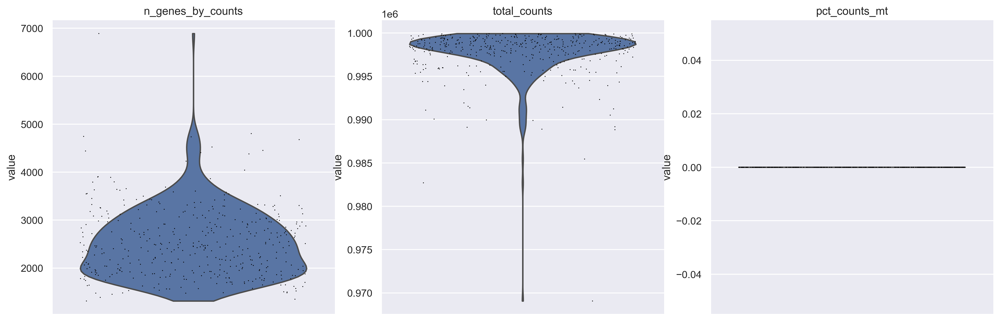

<Figure size 1600x1200 with 0 Axes>

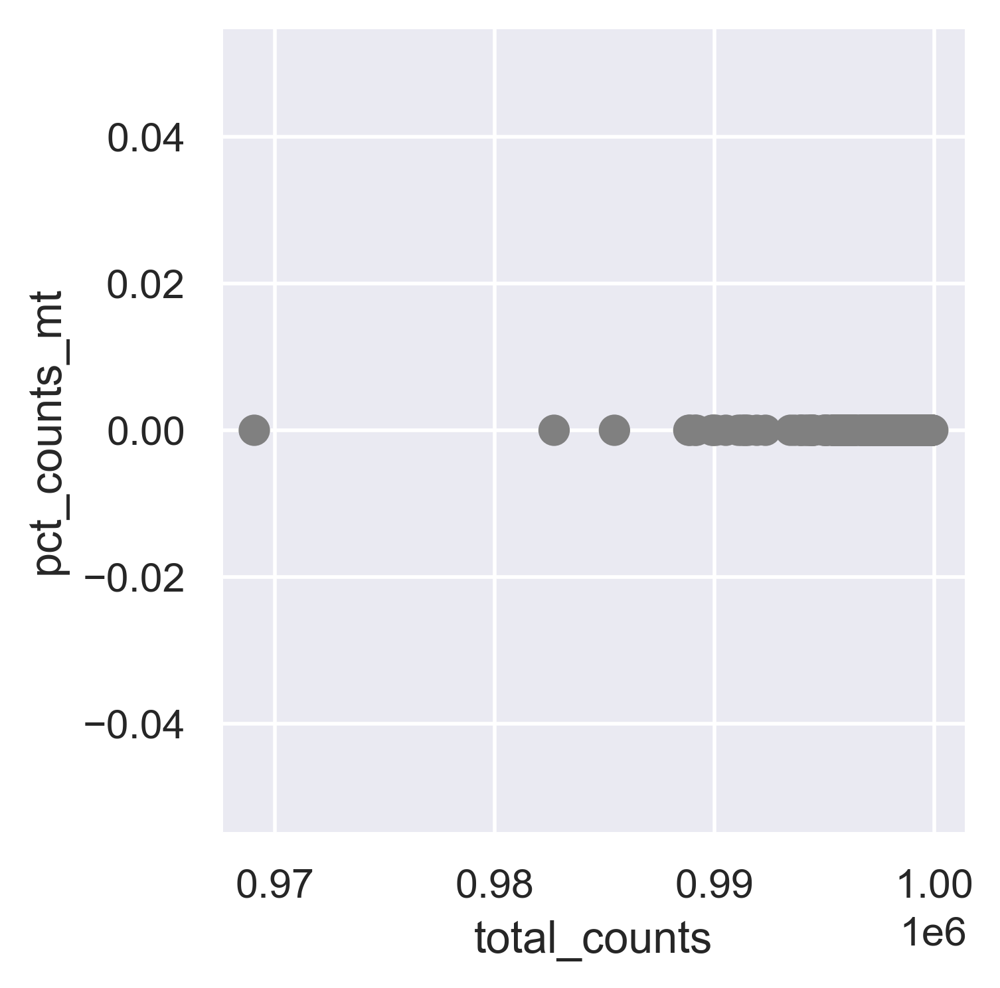

<Figure size 1600x1200 with 0 Axes>

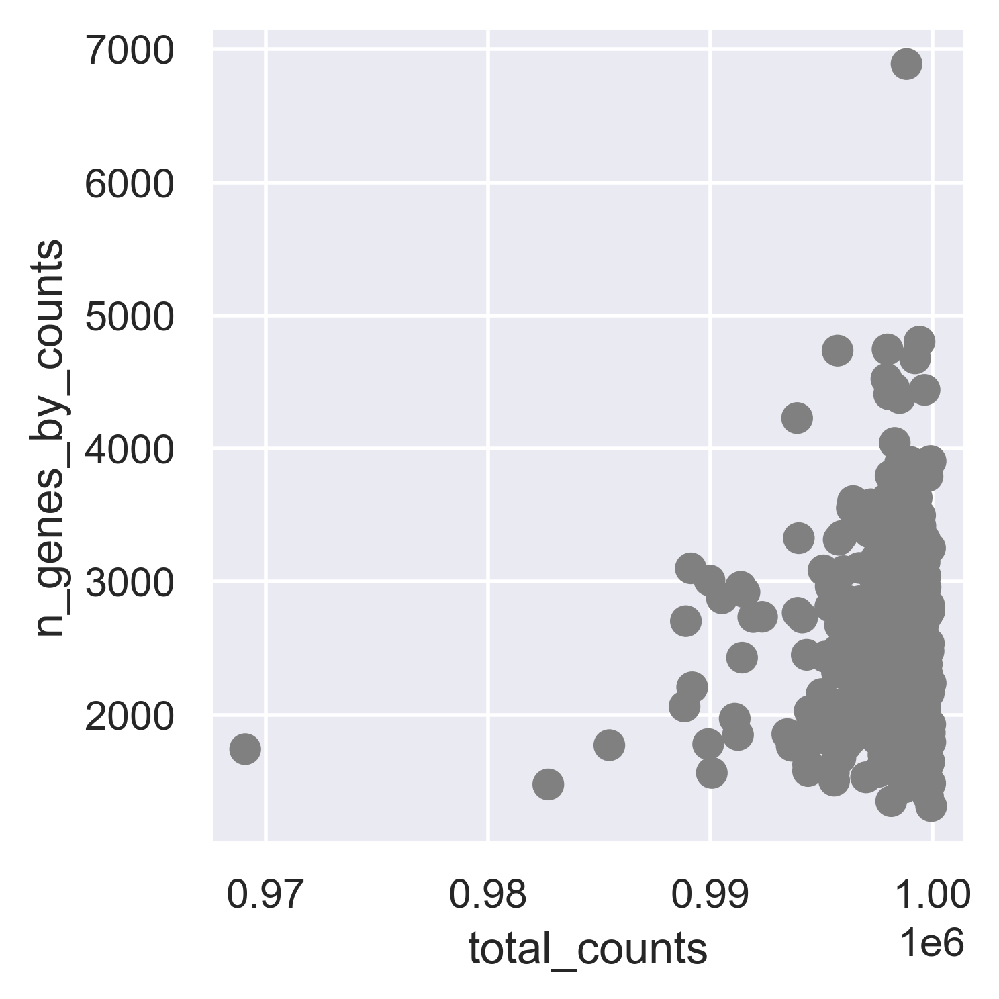

f:\tools\miniconda3\envs\deside3\lib\site-packages\scanpy\preprocessing\_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
... storing 'sample_id' as categorical
... storing 'majorCluster' as categorical
... storing 'sampleType' as categorical
... storing 'cell_type' as categorical


   The shape of adata after filtering is: (413, 13865)
#----------------------------------------------
Deal with P0913...
   The shape of adata before filtering is: (579, 23370)


<Figure size 3000x600 with 0 Axes>

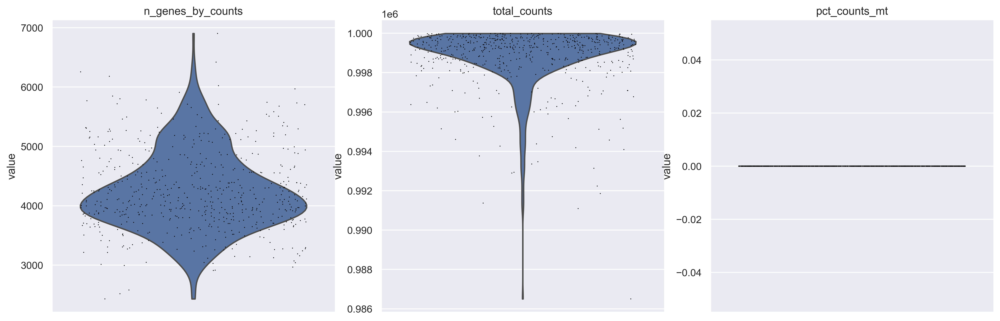

<Figure size 1600x1200 with 0 Axes>

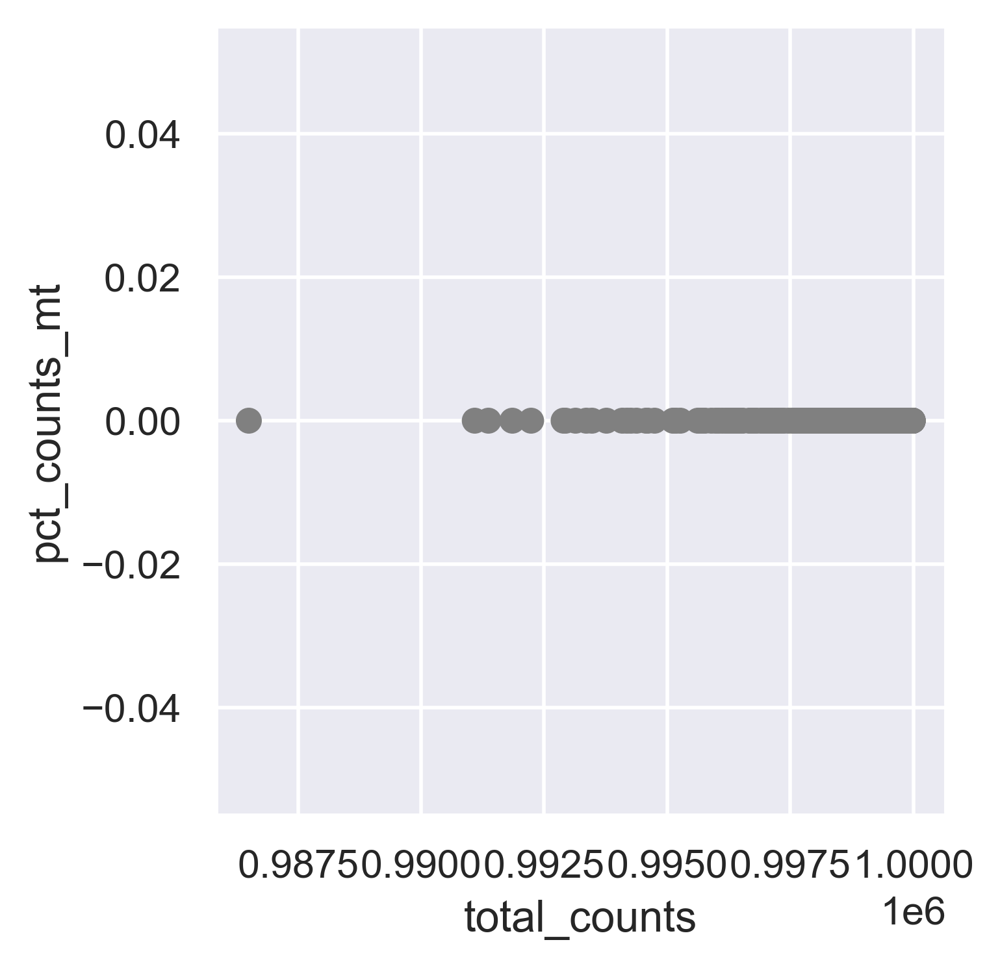

<Figure size 1600x1200 with 0 Axes>

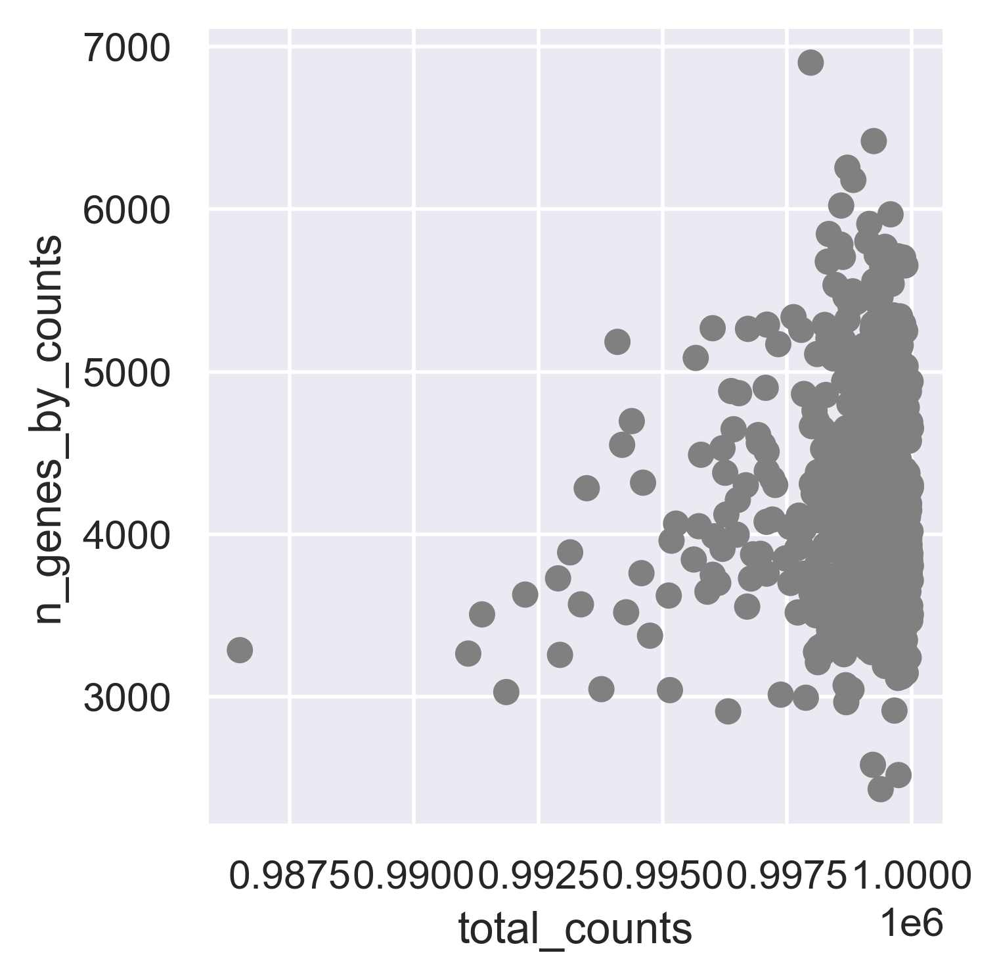

f:\tools\miniconda3\envs\deside3\lib\site-packages\scanpy\preprocessing\_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
... storing 'sample_id' as categorical
... storing 'majorCluster' as categorical
... storing 'sampleType' as categorical
... storing 'cell_type' as categorical


   The shape of adata after filtering is: (574, 16588)
#----------------------------------------------
Deal with P1118...
   The shape of adata before filtering is: (385, 23370)


<Figure size 3000x600 with 0 Axes>

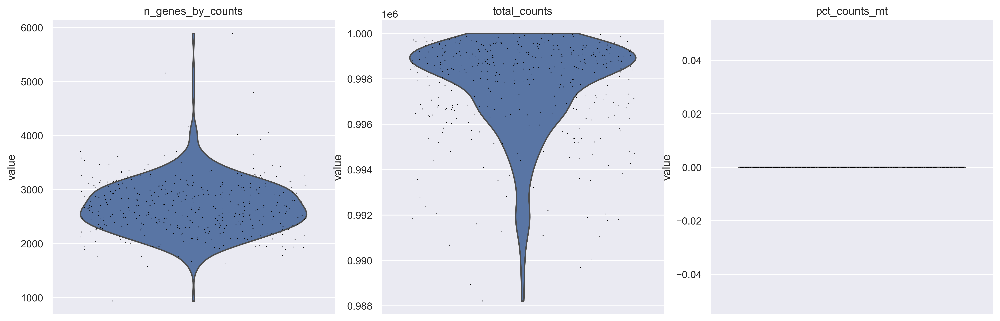

<Figure size 1600x1200 with 0 Axes>

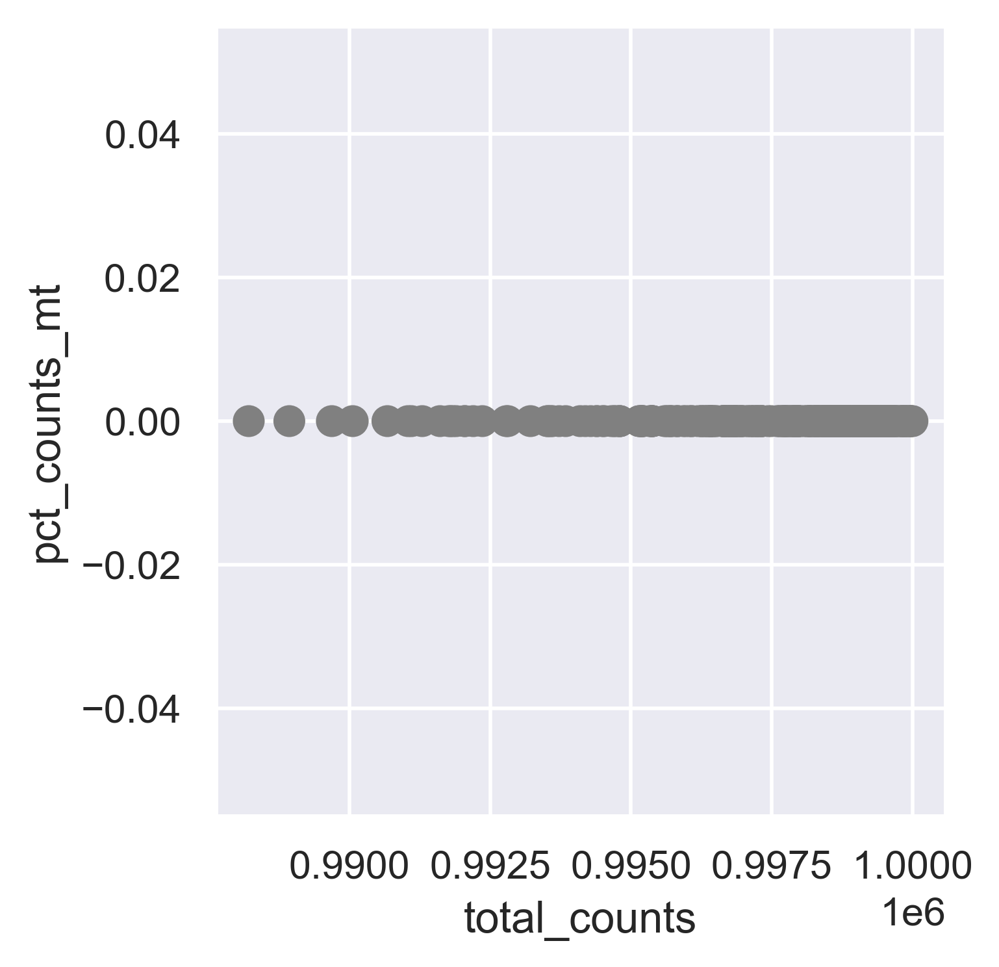

<Figure size 1600x1200 with 0 Axes>

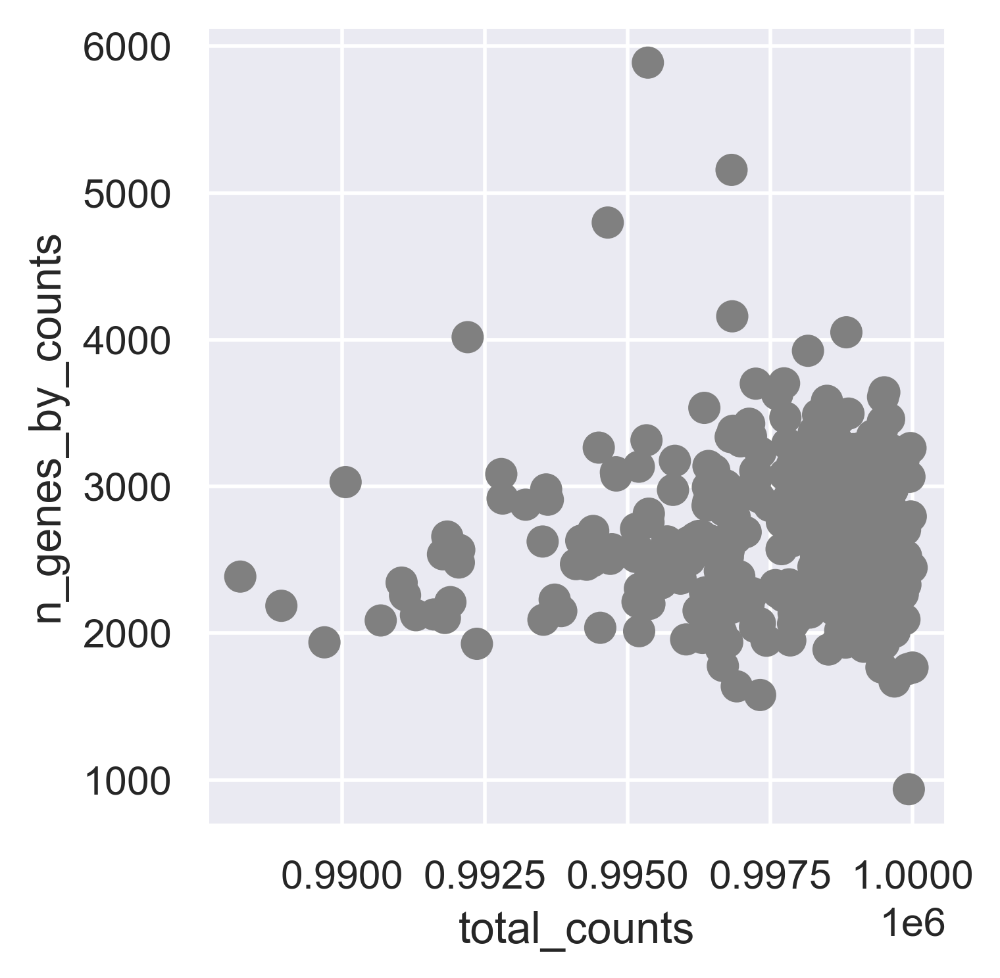

f:\tools\miniconda3\envs\deside3\lib\site-packages\scanpy\preprocessing\_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
... storing 'sample_id' as categorical
... storing 'majorCluster' as categorical
... storing 'sampleType' as categorical
... storing 'cell_type' as categorical


   The shape of adata after filtering is: (385, 13880)
#----------------------------------------------
Deal with P1120...
   The shape of adata before filtering is: (524, 23370)


<Figure size 3000x600 with 0 Axes>

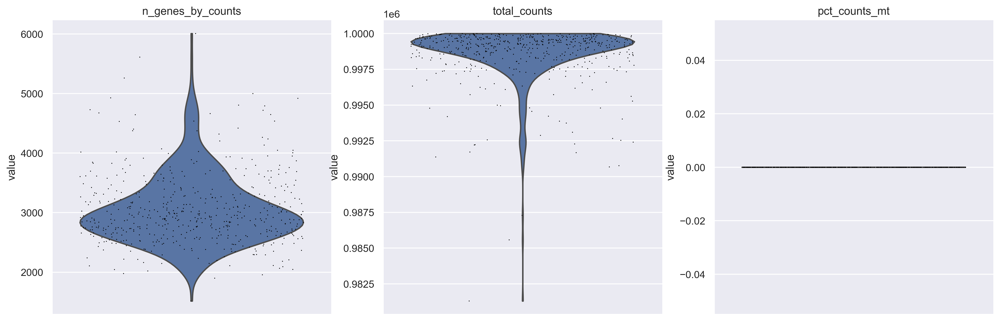

<Figure size 1600x1200 with 0 Axes>

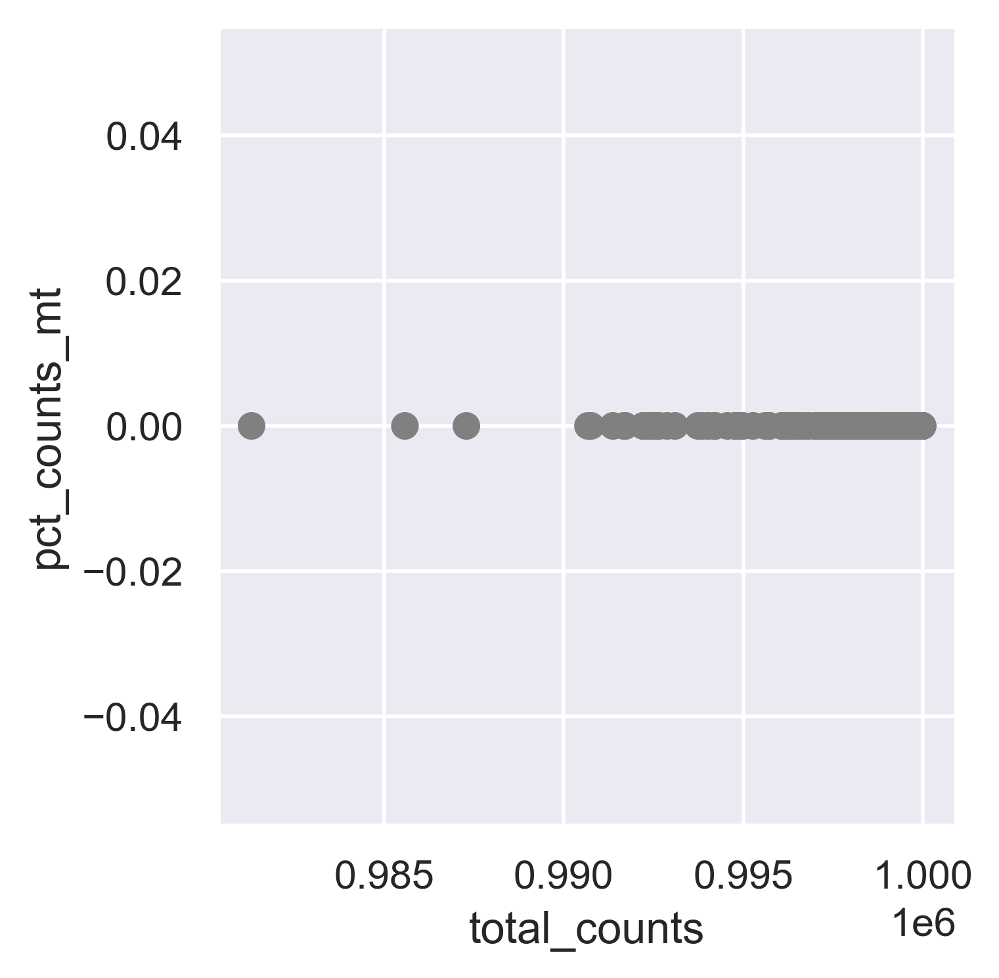

<Figure size 1600x1200 with 0 Axes>

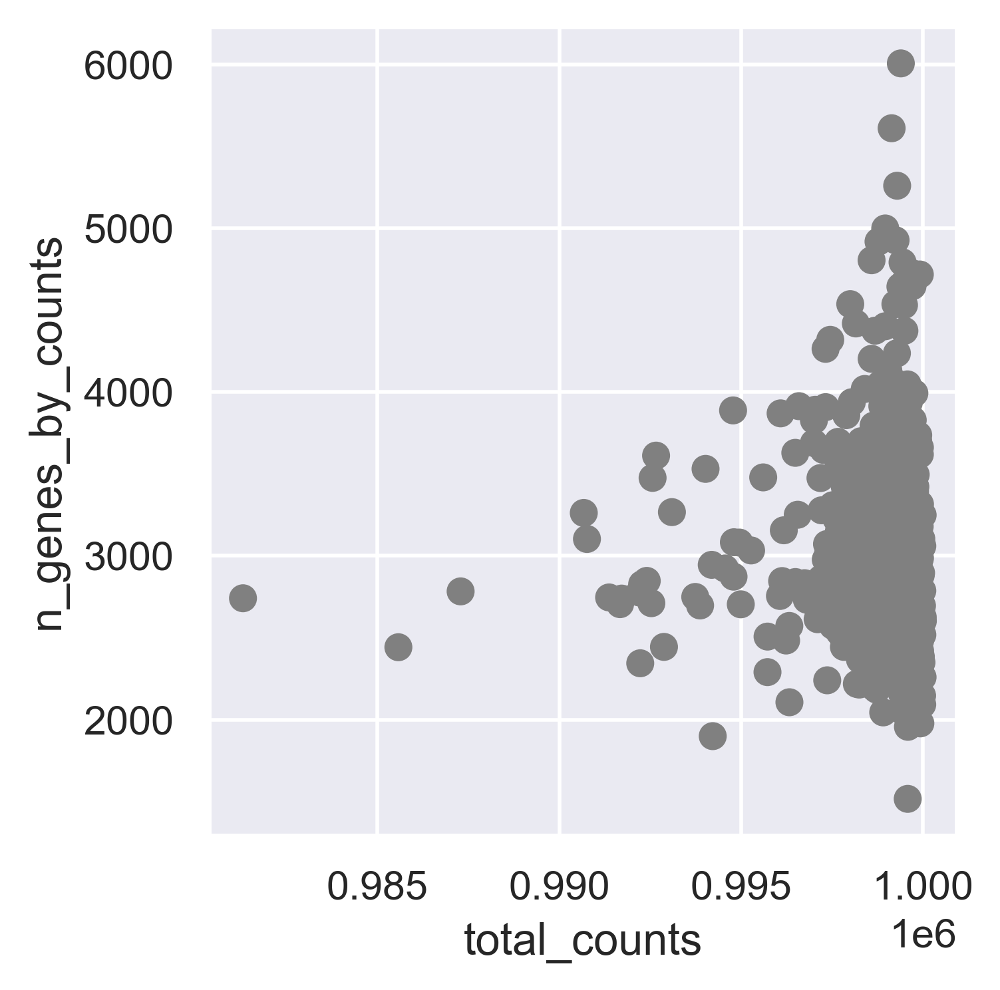

f:\tools\miniconda3\envs\deside3\lib\site-packages\scanpy\preprocessing\_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
... storing 'sample_id' as categorical
... storing 'majorCluster' as categorical
... storing 'sampleType' as categorical
... storing 'cell_type' as categorical


   The shape of adata after filtering is: (523, 13812)
#----------------------------------------------
Deal with P1208...
   The shape of adata before filtering is: (164, 23370)


<Figure size 3000x600 with 0 Axes>

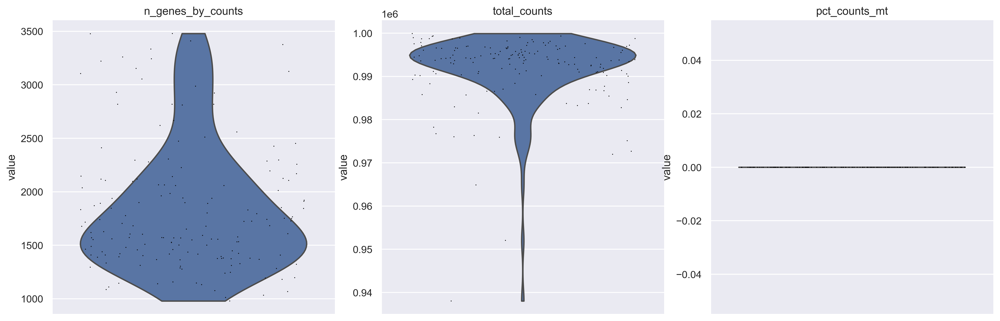

<Figure size 1600x1200 with 0 Axes>

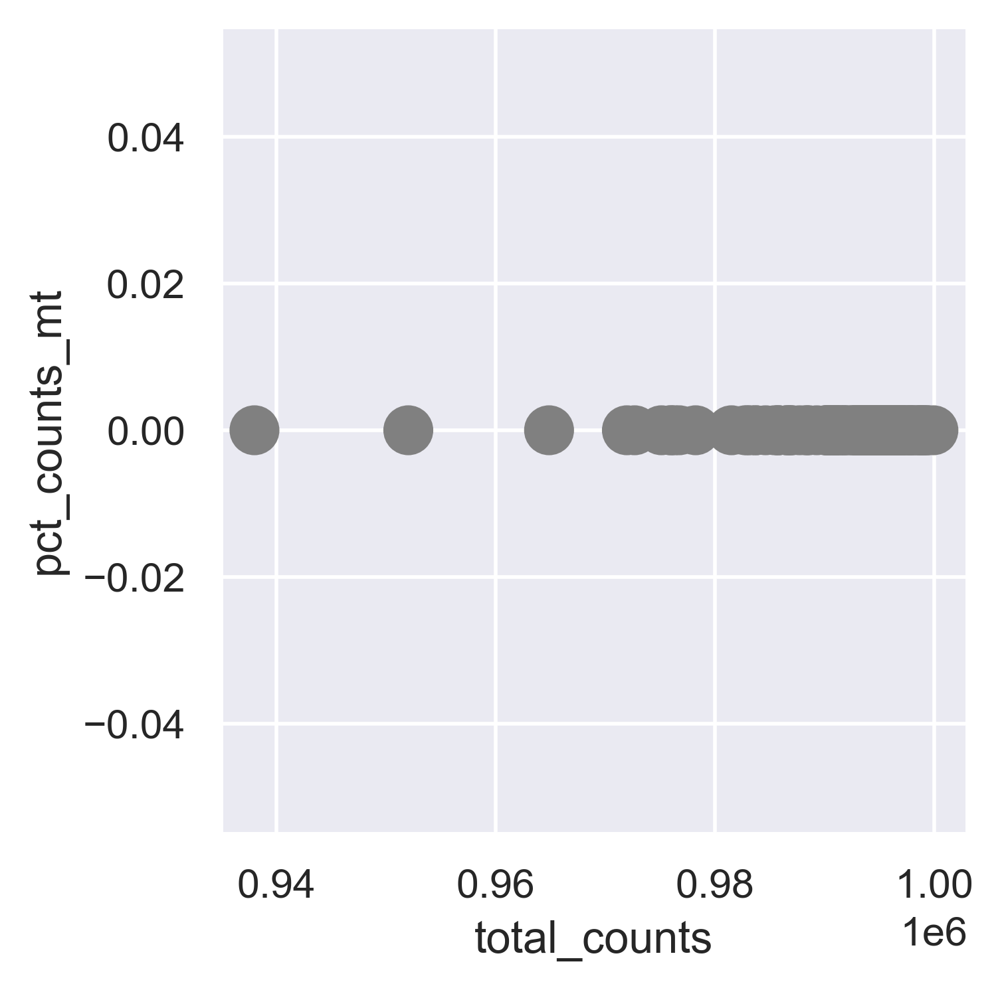

<Figure size 1600x1200 with 0 Axes>

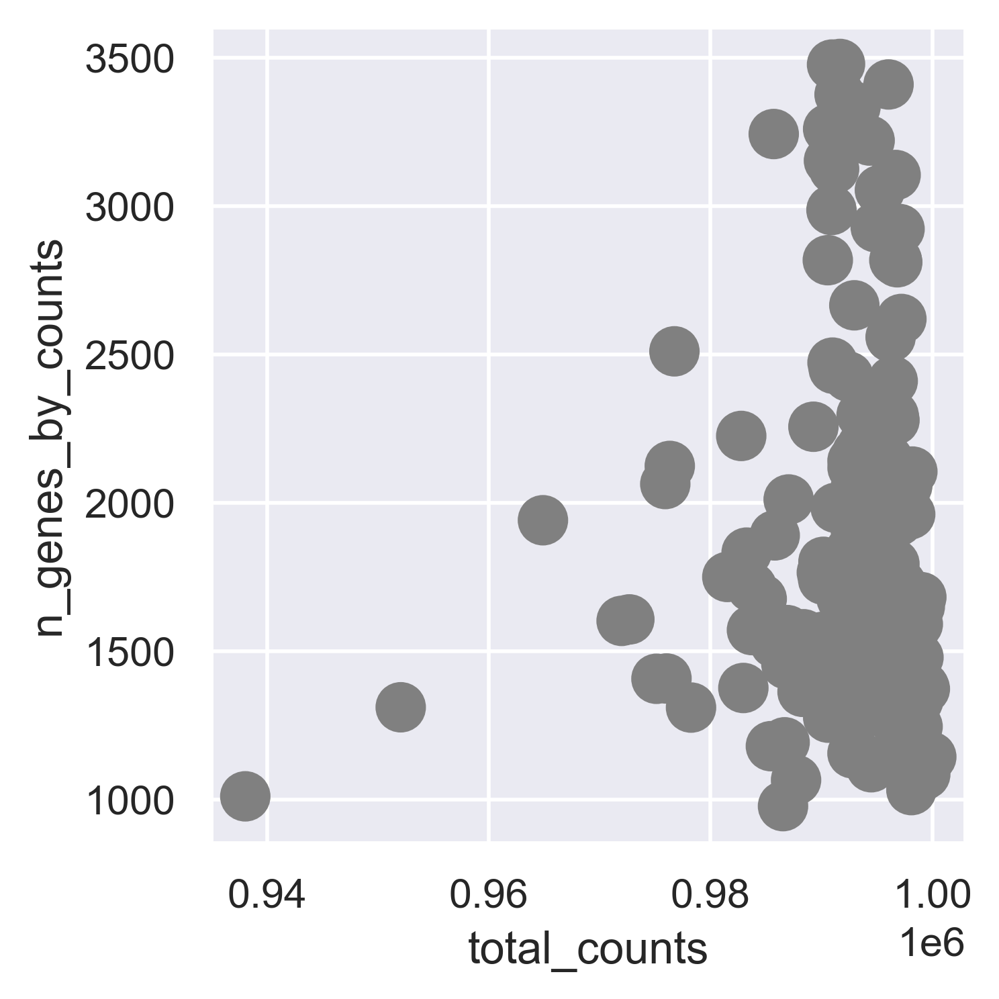

f:\tools\miniconda3\envs\deside3\lib\site-packages\scanpy\preprocessing\_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
... storing 'sample_id' as categorical
... storing 'majorCluster' as categorical
... storing 'sampleType' as categorical
... storing 'cell_type' as categorical


   The shape of adata after filtering is: (164, 11741)
#----------------------------------------------
Deal with P1202...
   The shape of adata before filtering is: (437, 23370)


<Figure size 3000x600 with 0 Axes>

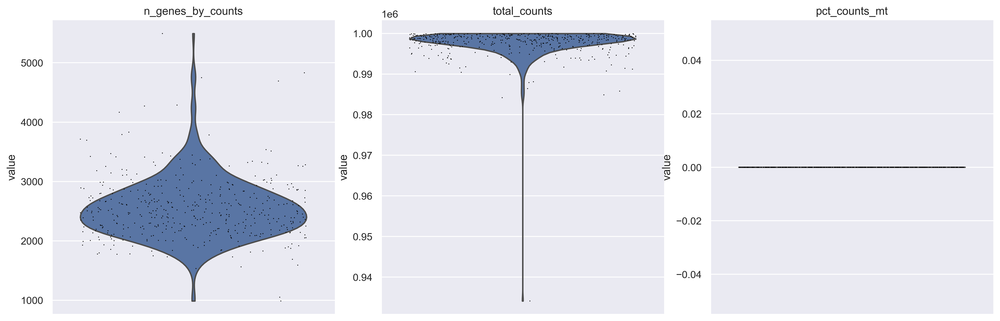

<Figure size 1600x1200 with 0 Axes>

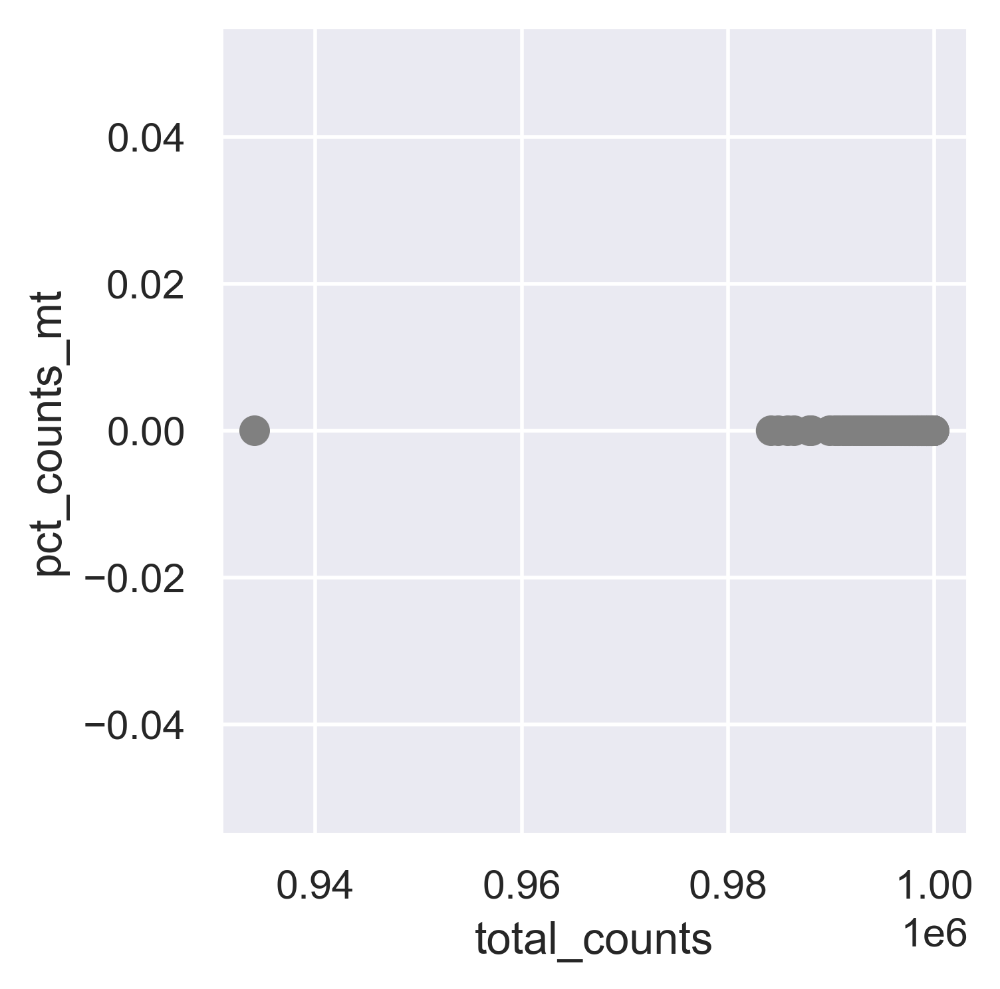

<Figure size 1600x1200 with 0 Axes>

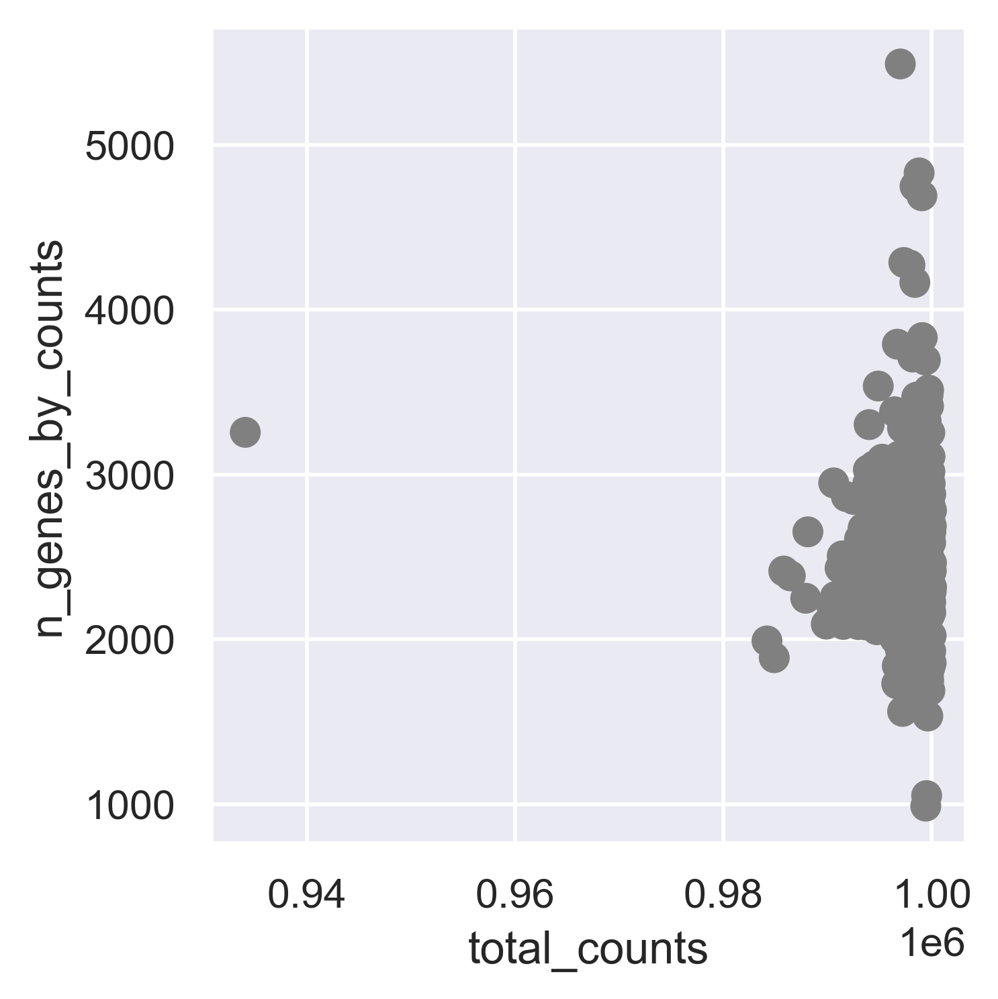

f:\tools\miniconda3\envs\deside3\lib\site-packages\scanpy\preprocessing\_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
... storing 'sample_id' as categorical
... storing 'majorCluster' as categorical
... storing 'sampleType' as categorical
... storing 'cell_type' as categorical


   The shape of adata after filtering is: (437, 14362)
#----------------------------------------------
Deal with P0616A...
   The shape of adata before filtering is: (415, 23370)


<Figure size 3000x600 with 0 Axes>

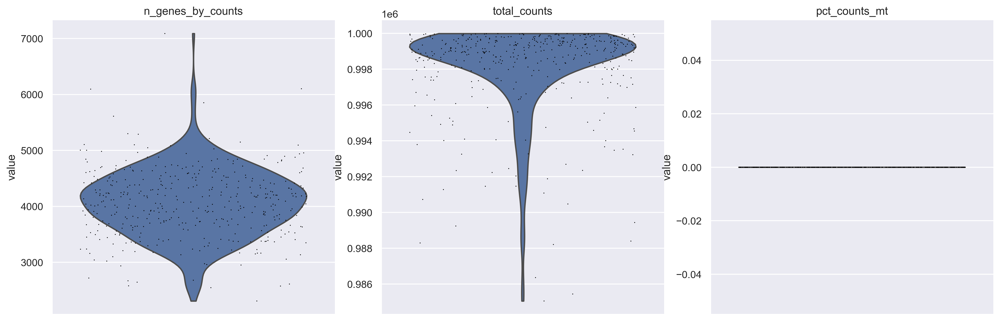

<Figure size 1600x1200 with 0 Axes>

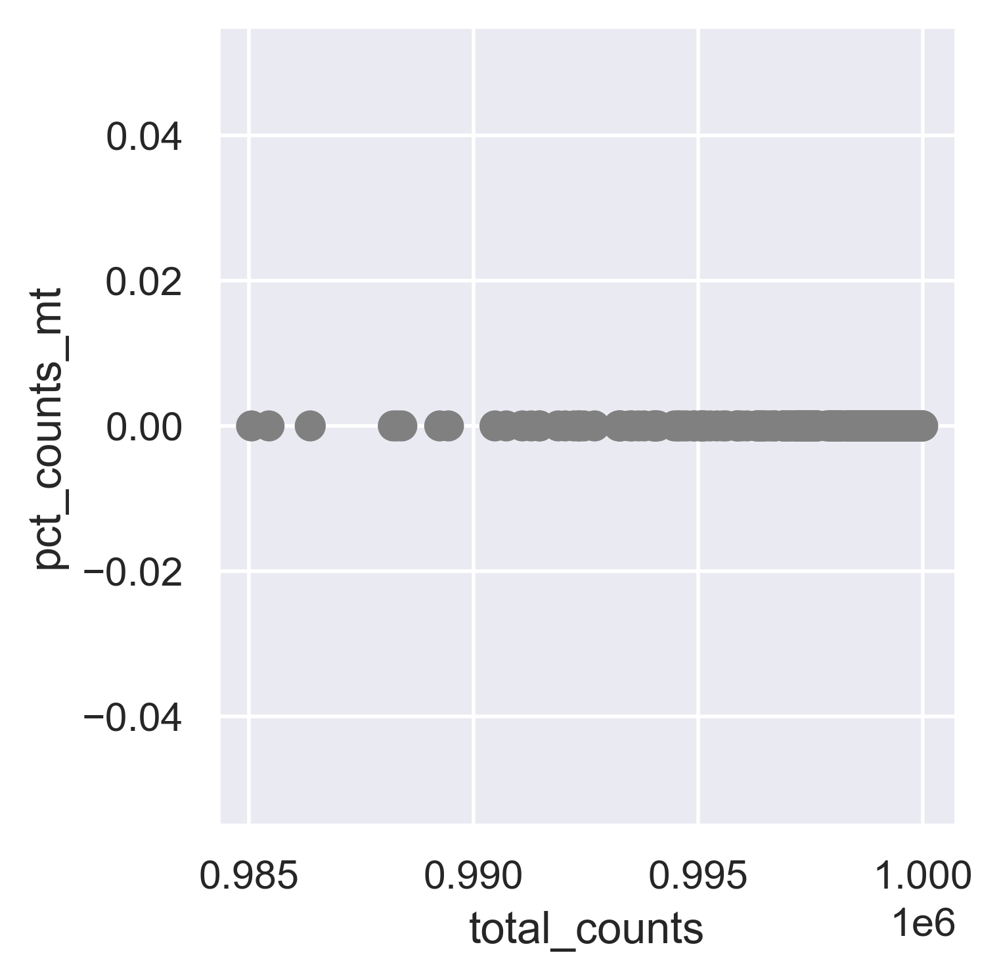

<Figure size 1600x1200 with 0 Axes>

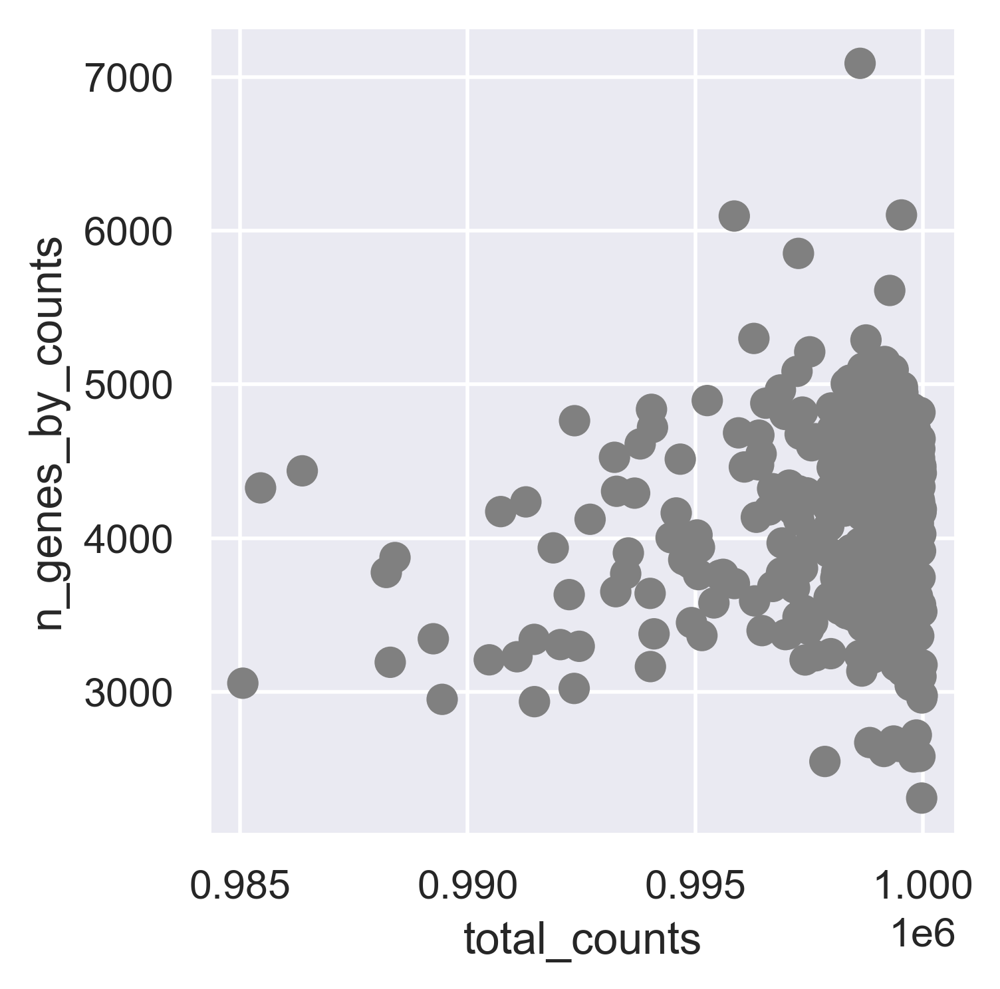

f:\tools\miniconda3\envs\deside3\lib\site-packages\scanpy\preprocessing\_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
... storing 'sample_id' as categorical
... storing 'majorCluster' as categorical
... storing 'sampleType' as categorical
... storing 'cell_type' as categorical


   The shape of adata after filtering is: (412, 15581)
#----------------------------------------------
Deal with P0619...
   The shape of adata before filtering is: (253, 23370)


<Figure size 3000x600 with 0 Axes>

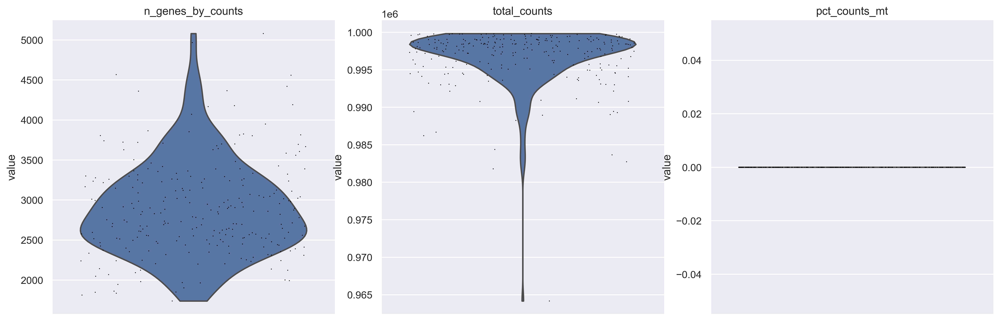

<Figure size 1600x1200 with 0 Axes>

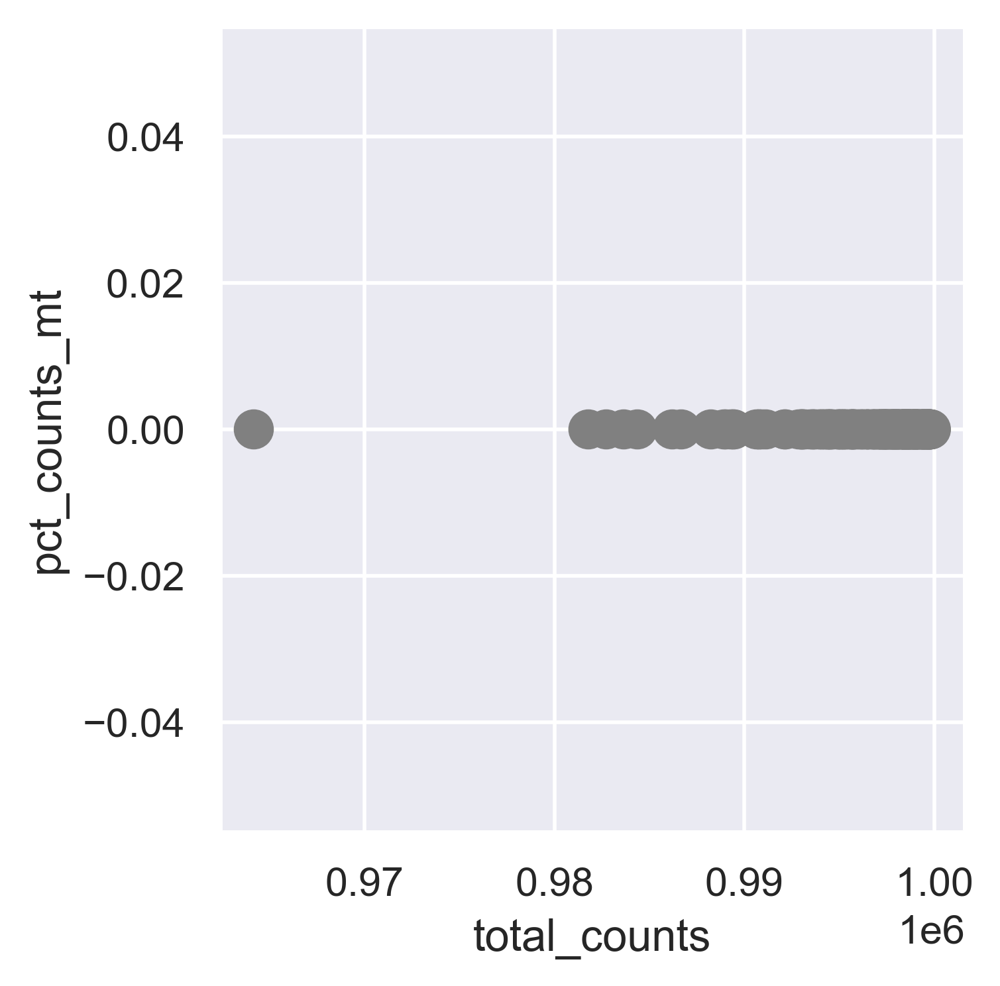

<Figure size 1600x1200 with 0 Axes>

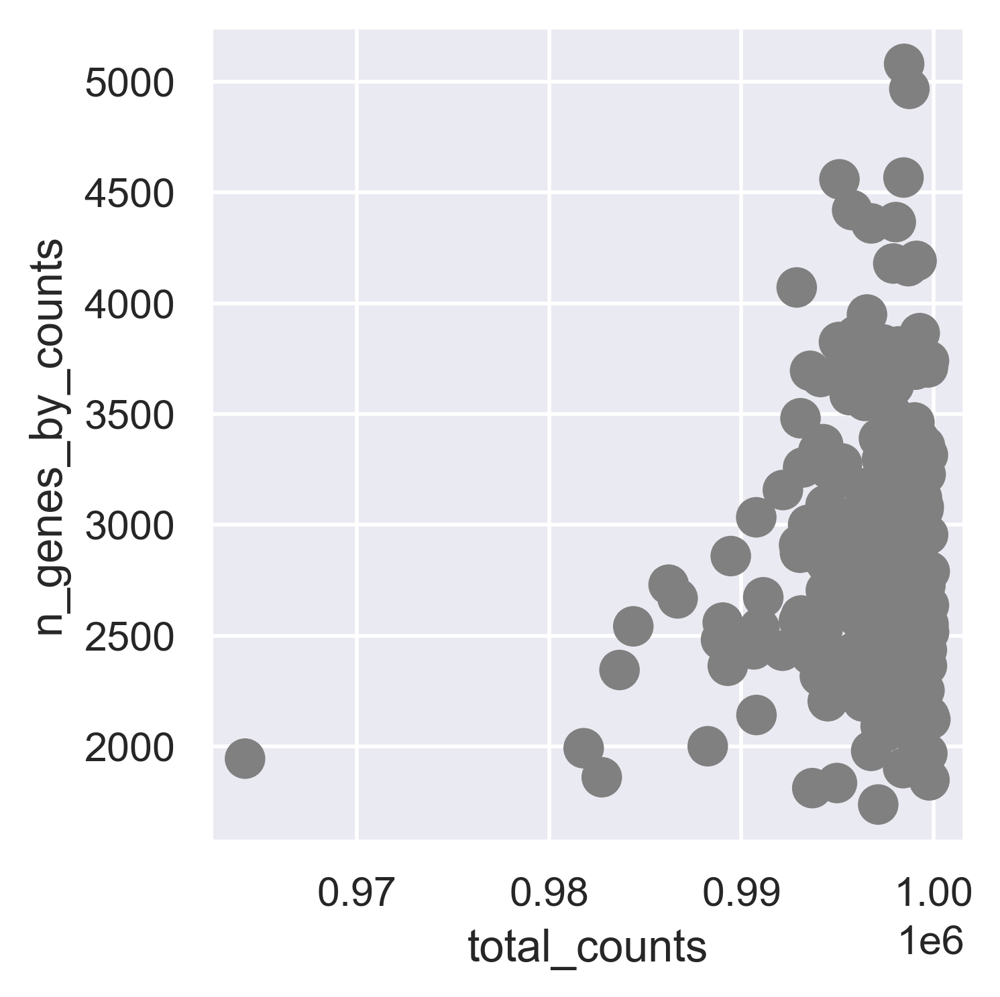

f:\tools\miniconda3\envs\deside3\lib\site-packages\scanpy\preprocessing\_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
... storing 'sample_id' as categorical
... storing 'majorCluster' as categorical
... storing 'sampleType' as categorical
... storing 'cell_type' as categorical


   The shape of adata after filtering is: (253, 12960)
#----------------------------------------------
Deal with P0617...
   The shape of adata before filtering is: (344, 23370)


<Figure size 3000x600 with 0 Axes>

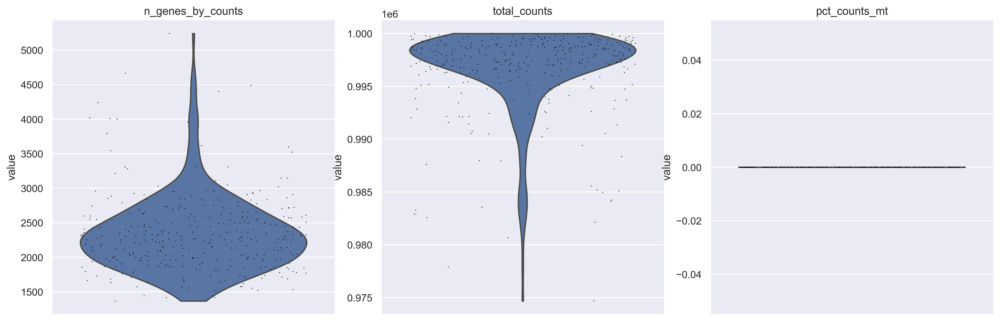

<Figure size 1600x1200 with 0 Axes>

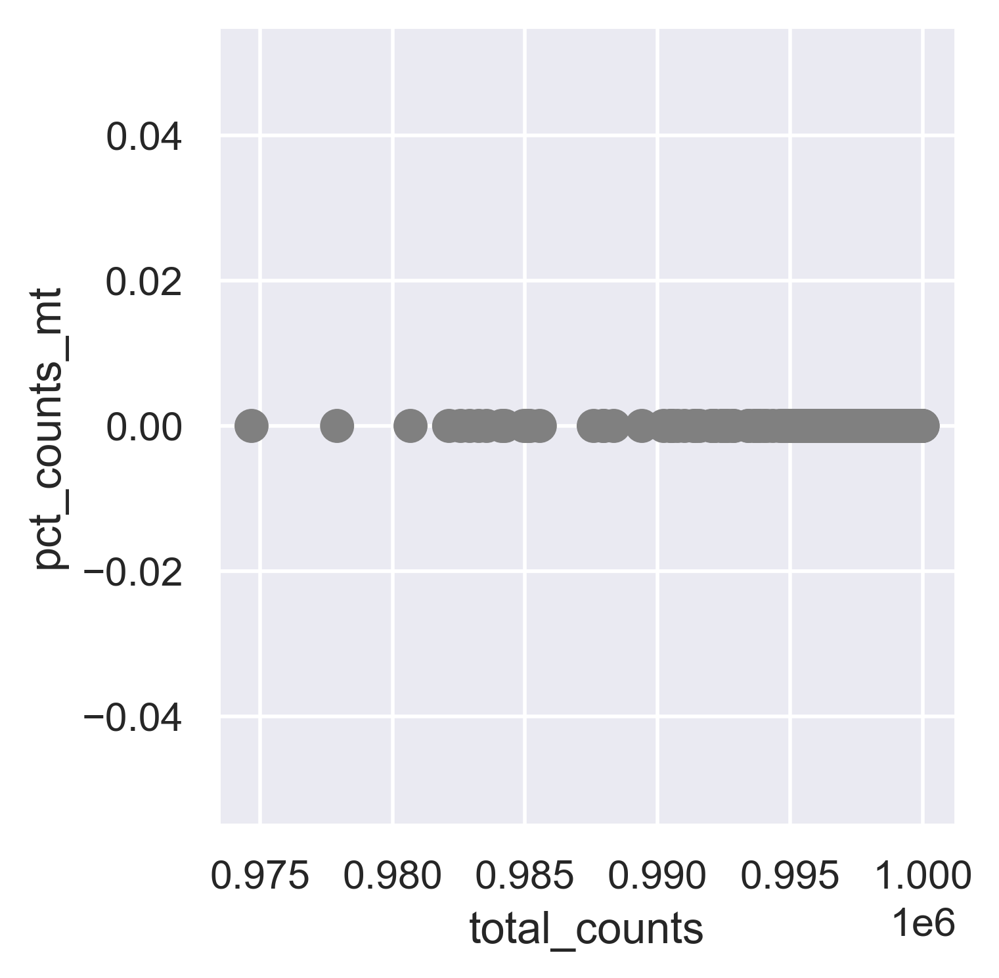

<Figure size 1600x1200 with 0 Axes>

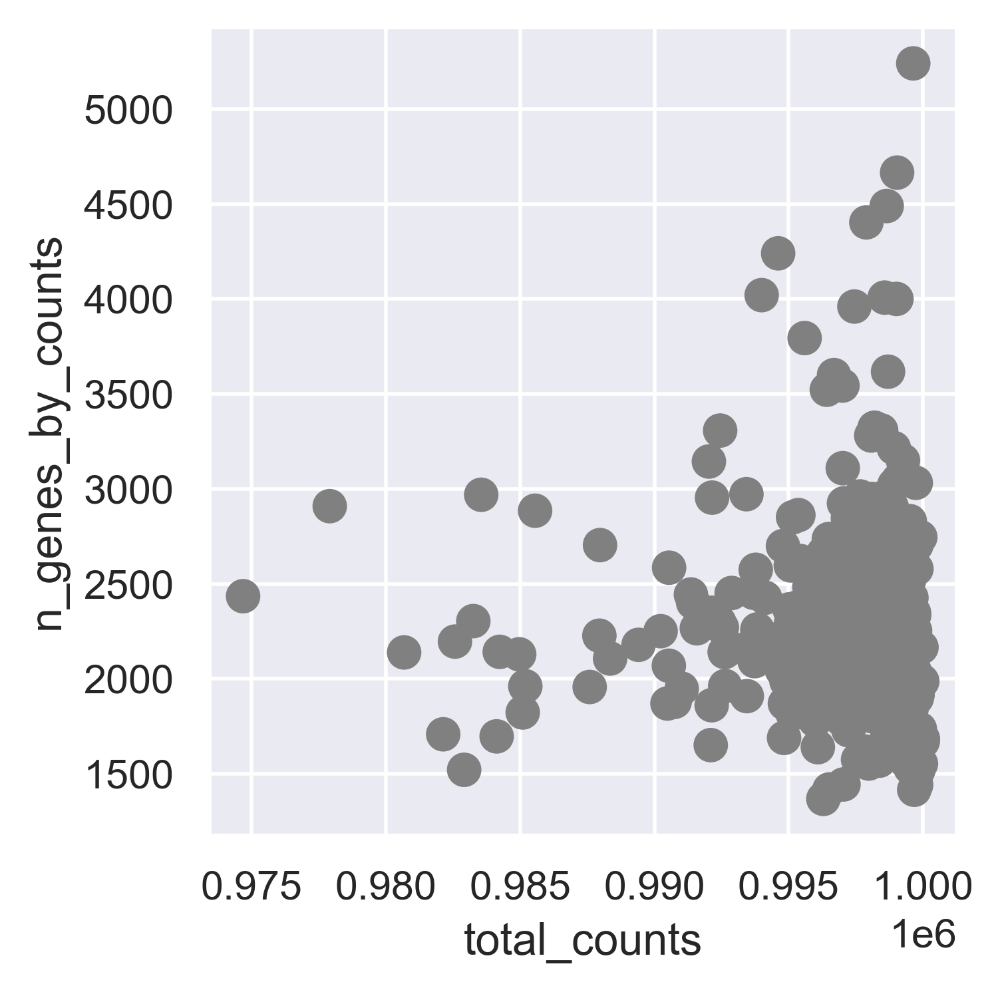

f:\tools\miniconda3\envs\deside3\lib\site-packages\scanpy\preprocessing\_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
... storing 'sample_id' as categorical
... storing 'majorCluster' as categorical
... storing 'sampleType' as categorical
... storing 'cell_type' as categorical


   The shape of adata after filtering is: (344, 13256)
#----------------------------------------------
Deal with P0729...
   The shape of adata before filtering is: (162, 23370)


<Figure size 3000x600 with 0 Axes>

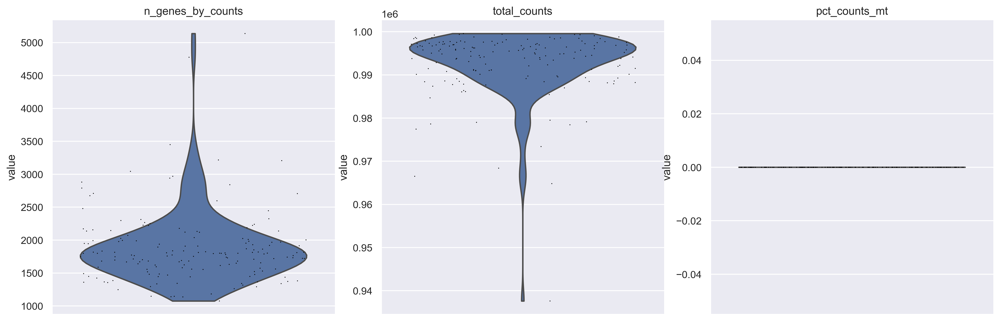

<Figure size 1600x1200 with 0 Axes>

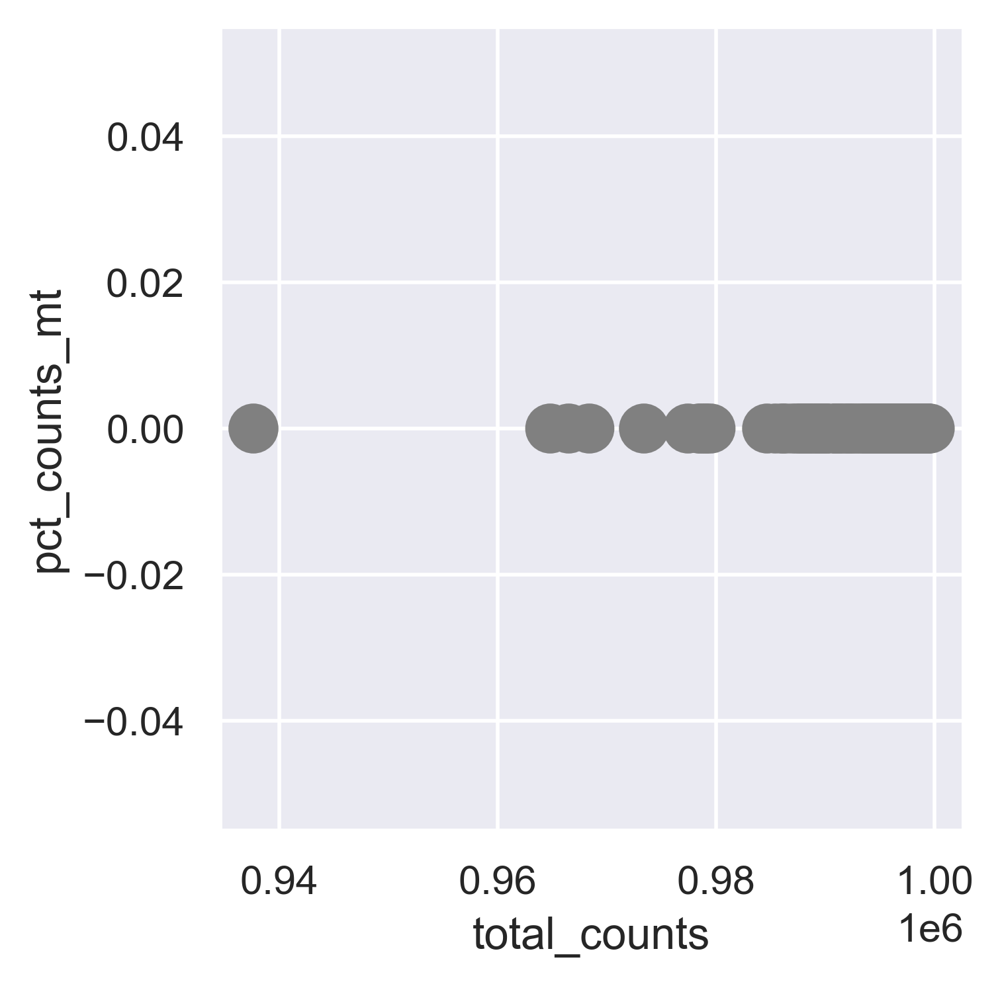

<Figure size 1600x1200 with 0 Axes>

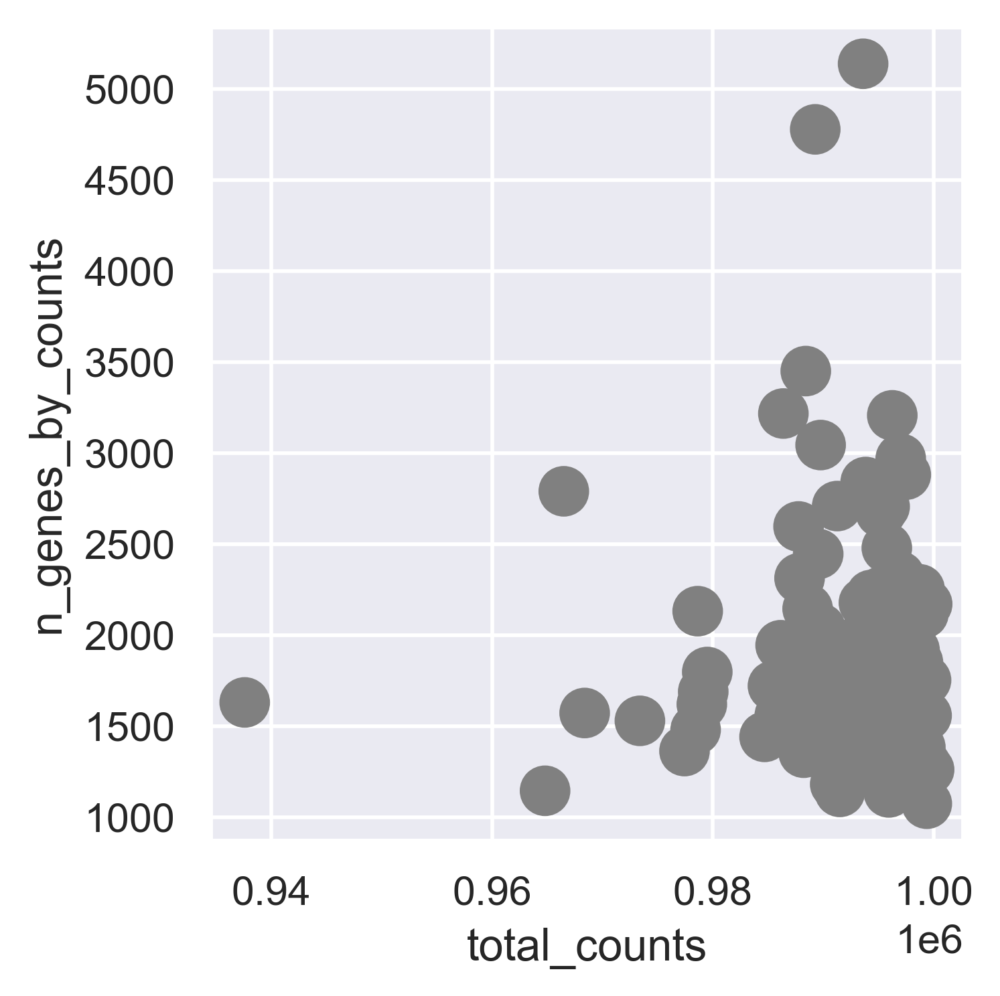

f:\tools\miniconda3\envs\deside3\lib\site-packages\scanpy\preprocessing\_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
... storing 'sample_id' as categorical
... storing 'majorCluster' as categorical
... storing 'sampleType' as categorical
... storing 'cell_type' as categorical


   The shape of adata after filtering is: (162, 11665)
#----------------------------------------------
Deal with P1010...
   The shape of adata before filtering is: (434, 23370)


<Figure size 3000x600 with 0 Axes>

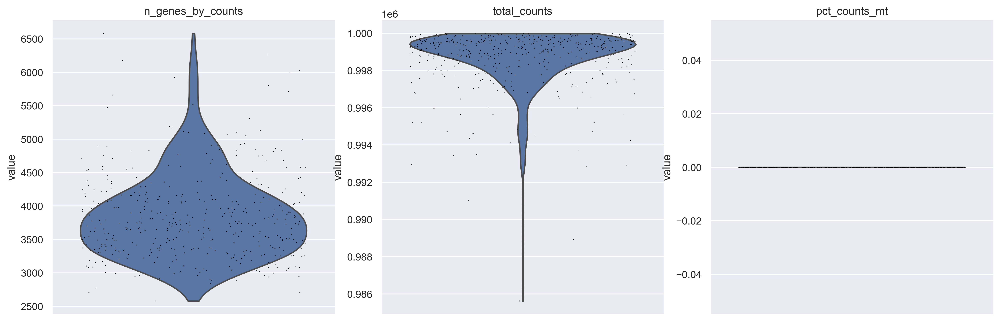

<Figure size 1600x1200 with 0 Axes>

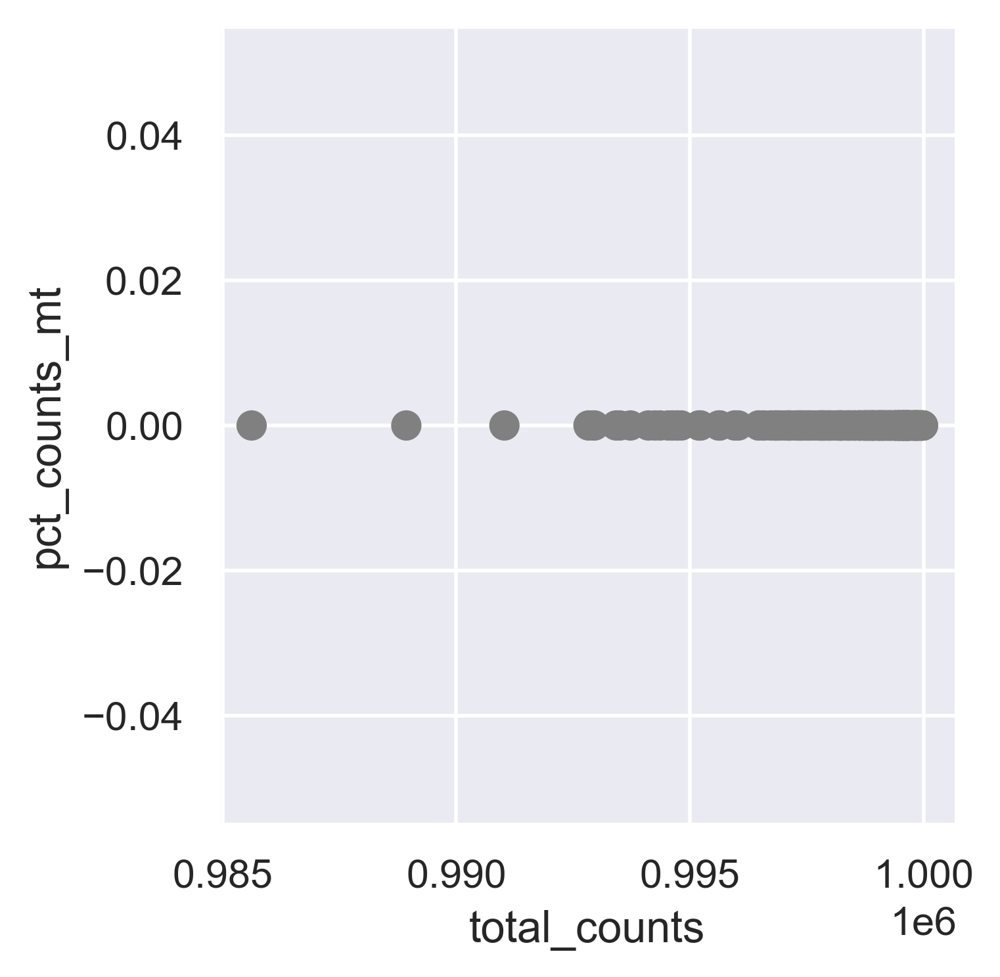

<Figure size 1600x1200 with 0 Axes>

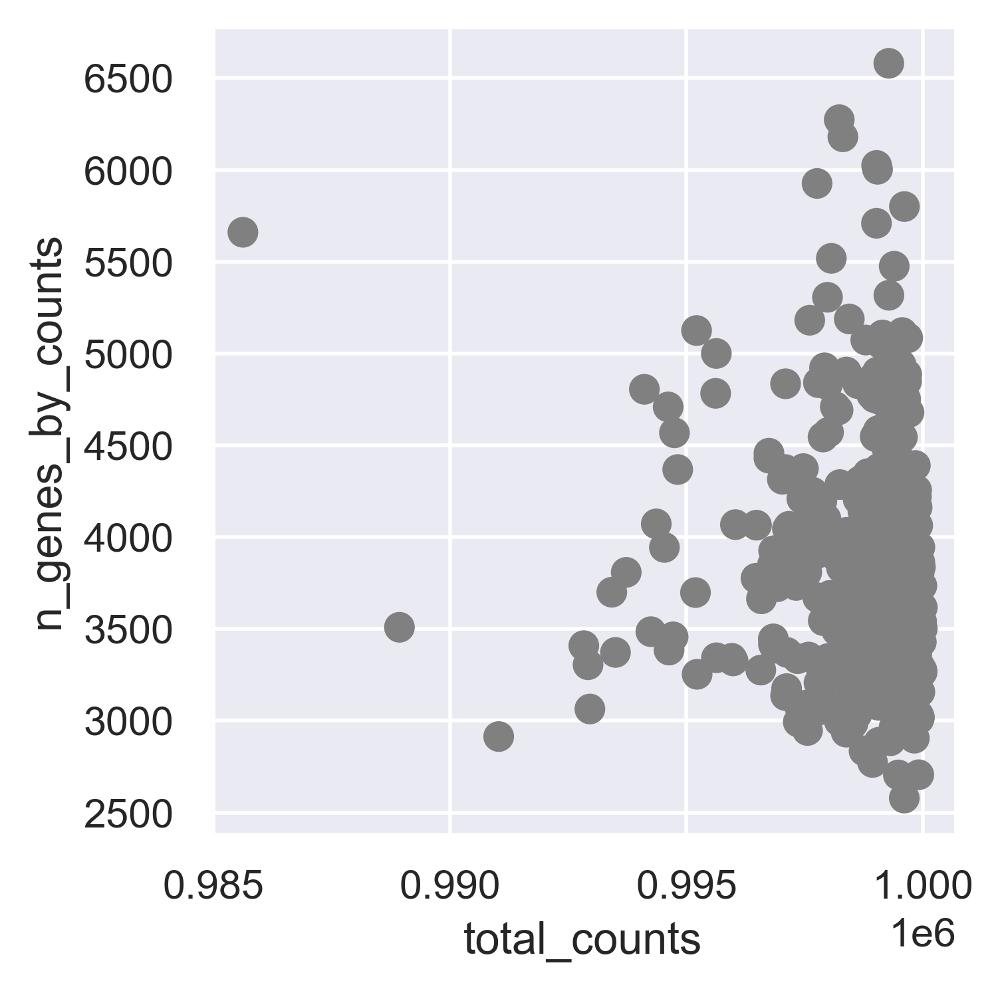

f:\tools\miniconda3\envs\deside3\lib\site-packages\scanpy\preprocessing\_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
... storing 'sample_id' as categorical
... storing 'majorCluster' as categorical
... storing 'sampleType' as categorical
... storing 'cell_type' as categorical


   The shape of adata after filtering is: (429, 14845)
#----------------------------------------------
Deal with P1011...
   The shape of adata before filtering is: (436, 23370)


<Figure size 3000x600 with 0 Axes>

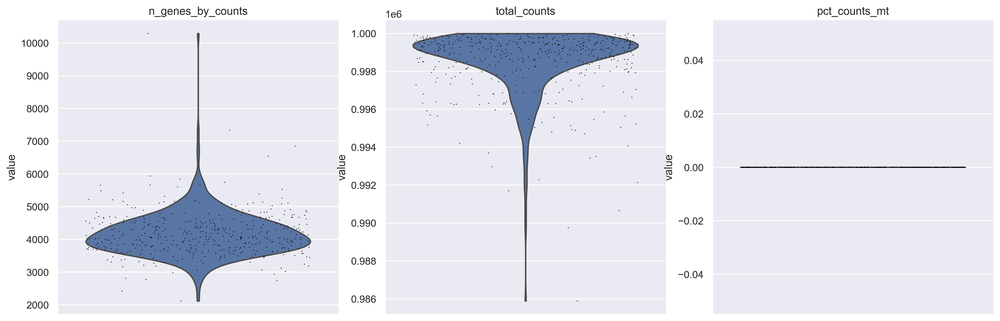

<Figure size 1600x1200 with 0 Axes>

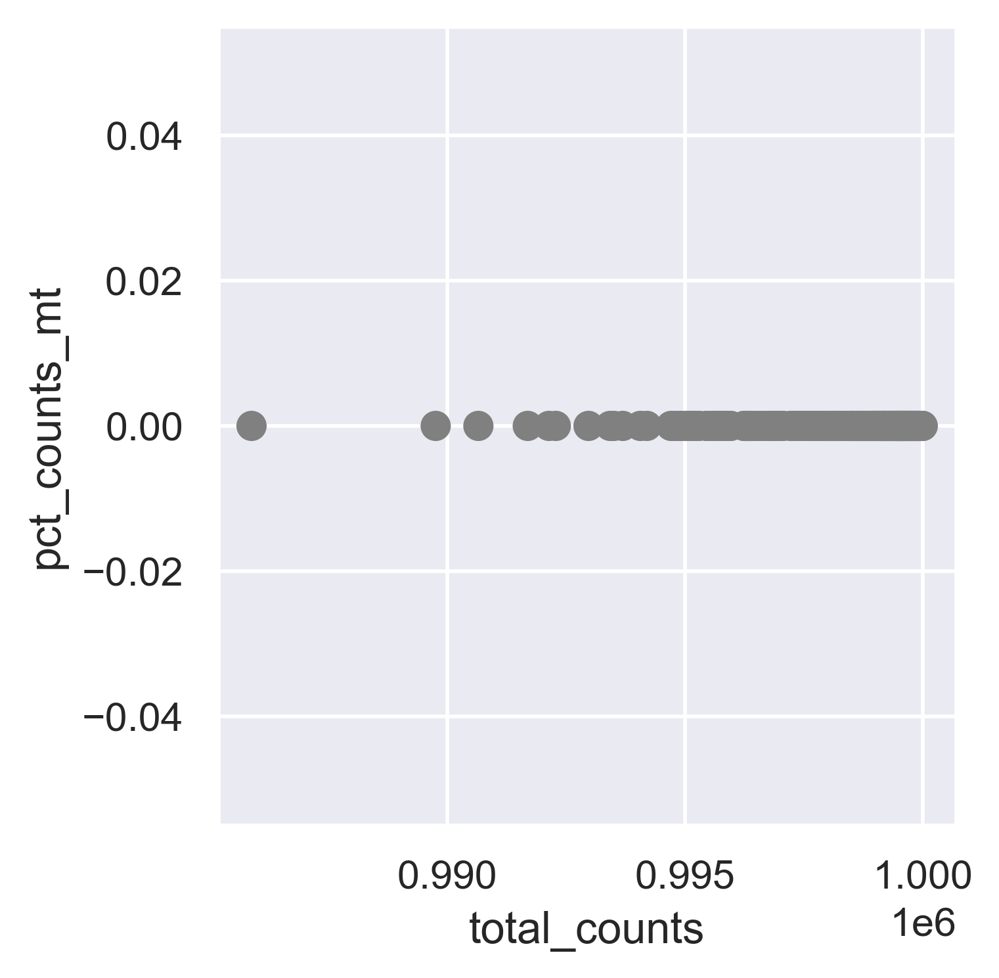

<Figure size 1600x1200 with 0 Axes>

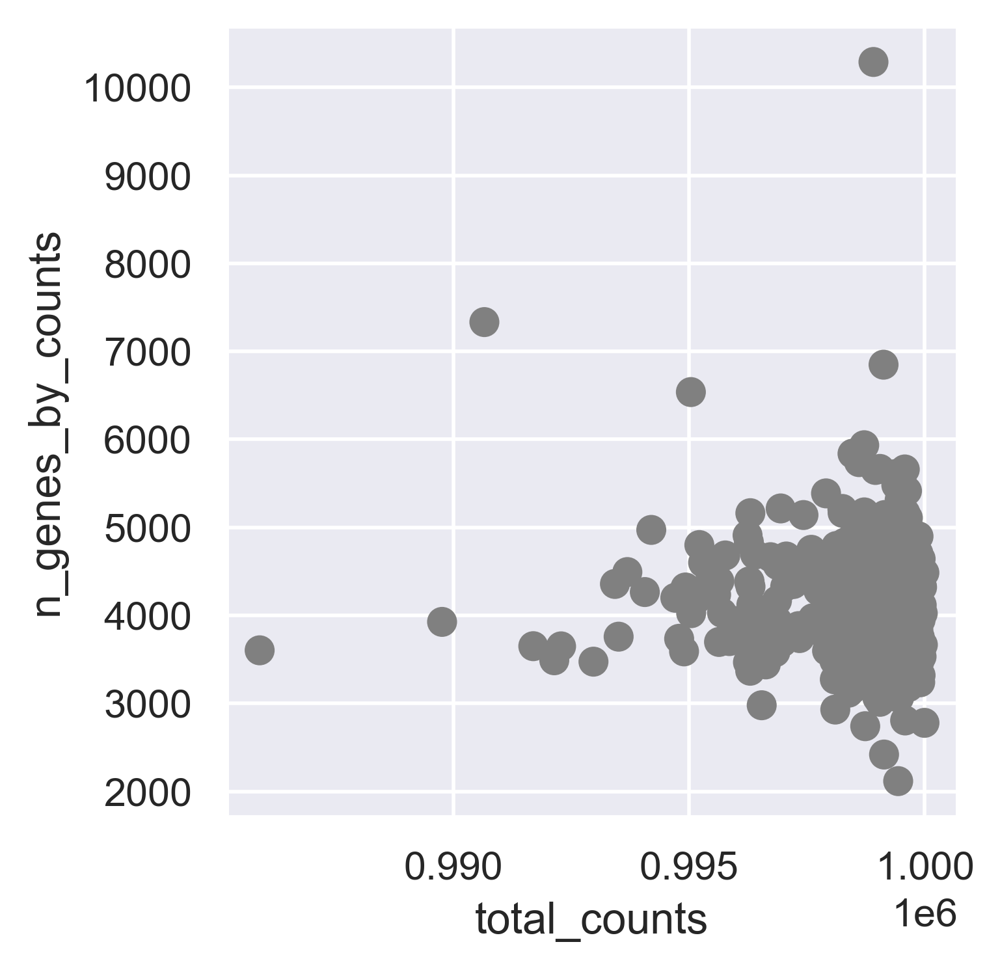

f:\tools\miniconda3\envs\deside3\lib\site-packages\scanpy\preprocessing\_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
... storing 'sample_id' as categorical
... storing 'majorCluster' as categorical
... storing 'sampleType' as categorical
... storing 'cell_type' as categorical


   The shape of adata after filtering is: (432, 15848)
#----------------------------------------------
Deal with P0616P...
   The shape of adata before filtering is: (129, 23370)


<Figure size 3000x600 with 0 Axes>

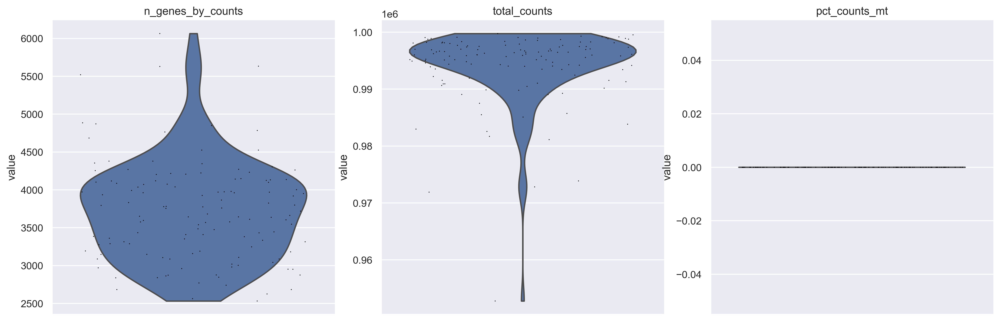

<Figure size 1600x1200 with 0 Axes>

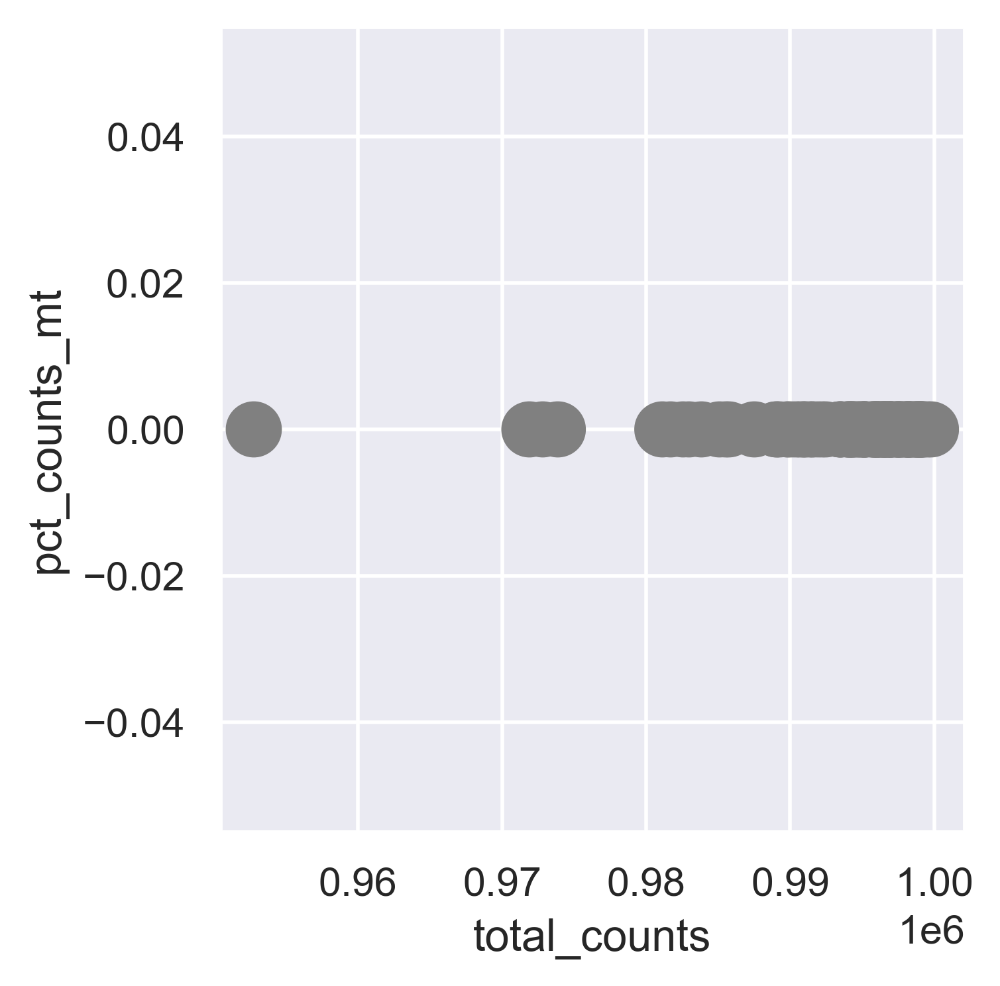

<Figure size 1600x1200 with 0 Axes>

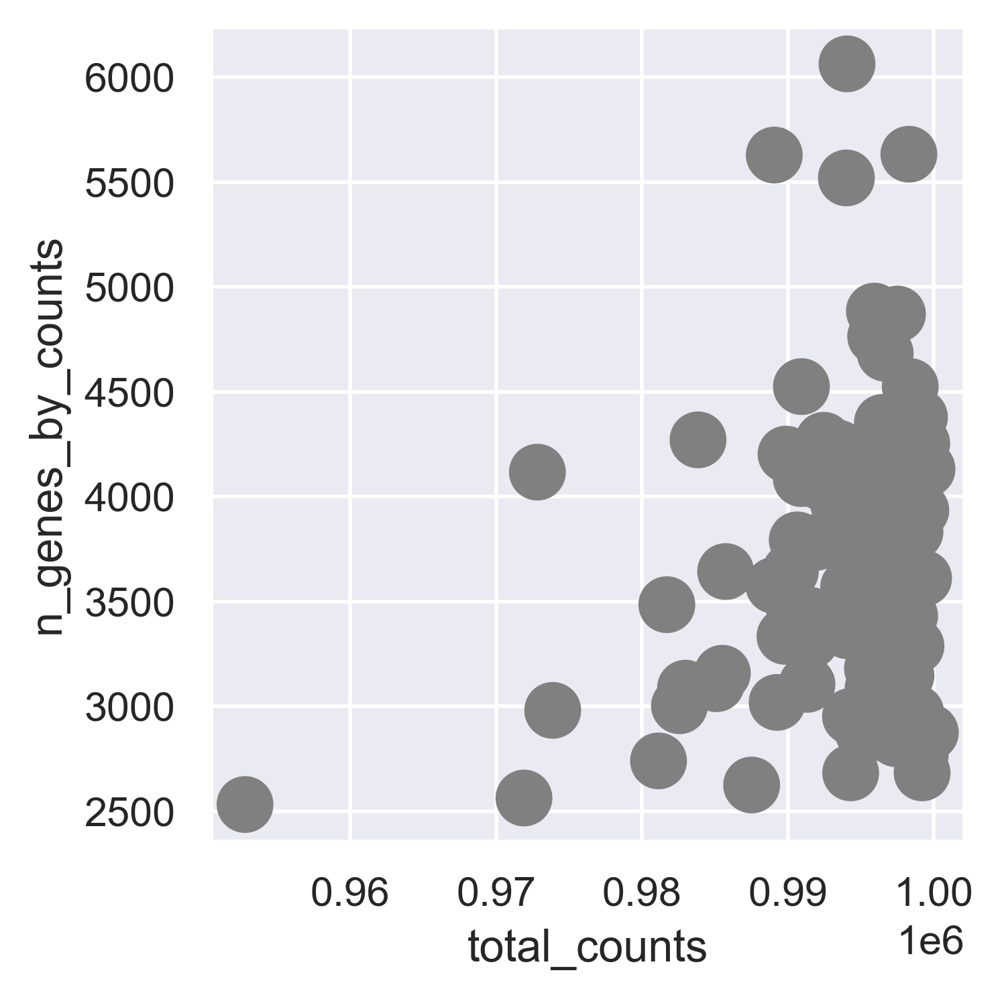

f:\tools\miniconda3\envs\deside3\lib\site-packages\scanpy\preprocessing\_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
... storing 'sample_id' as categorical
... storing 'majorCluster' as categorical
... storing 'sampleType' as categorical
... storing 'cell_type' as categorical


   The shape of adata after filtering is: (128, 12864)
#----------------------------------------------
Deal with P1219...
   The shape of adata before filtering is: (56, 23370)


<Figure size 3000x600 with 0 Axes>

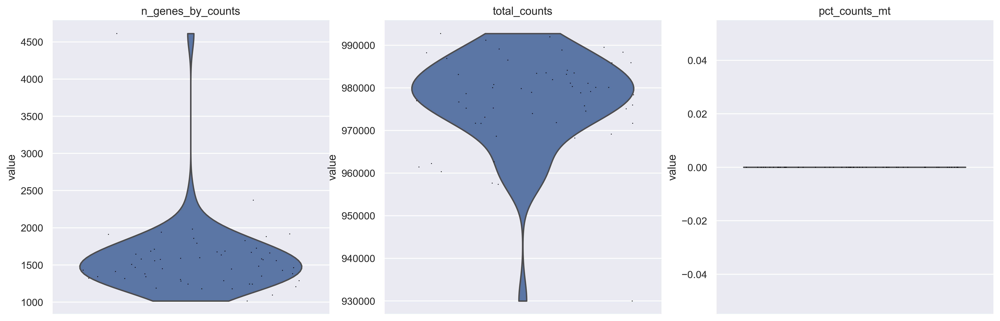

<Figure size 1600x1200 with 0 Axes>

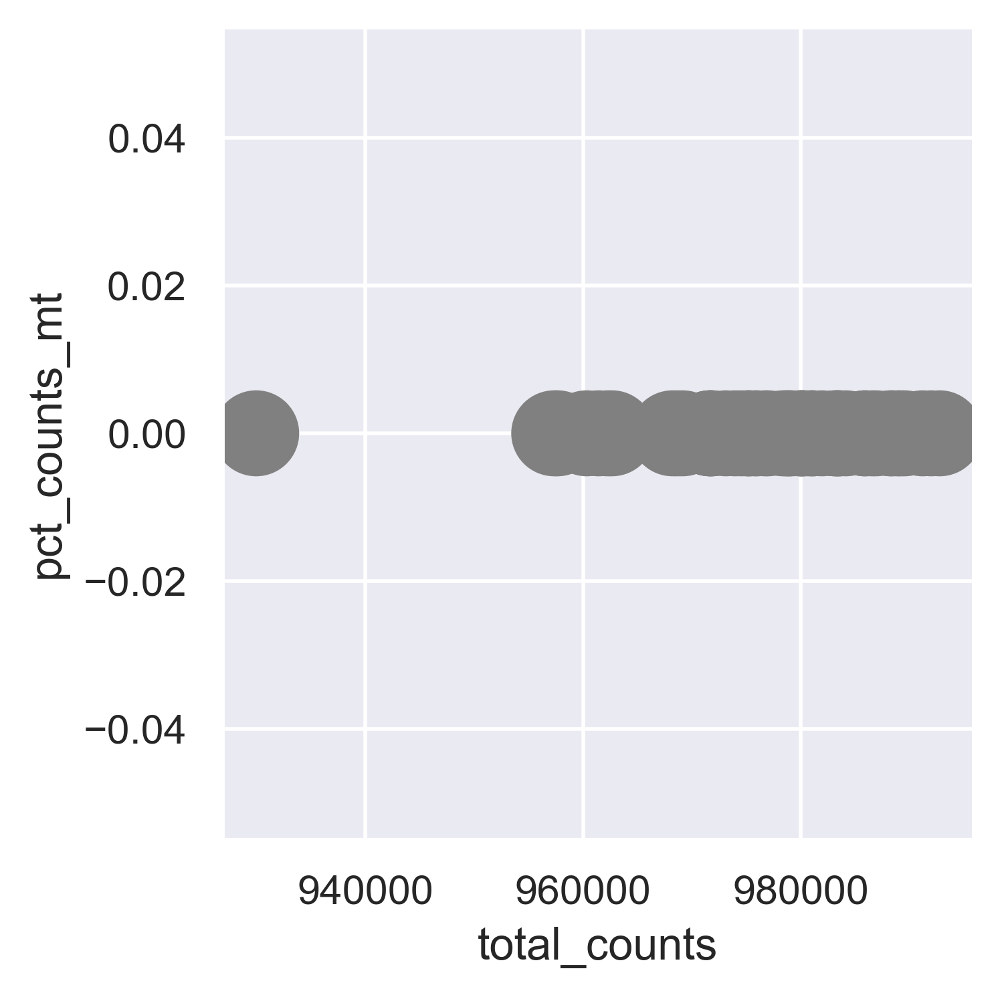

<Figure size 1600x1200 with 0 Axes>

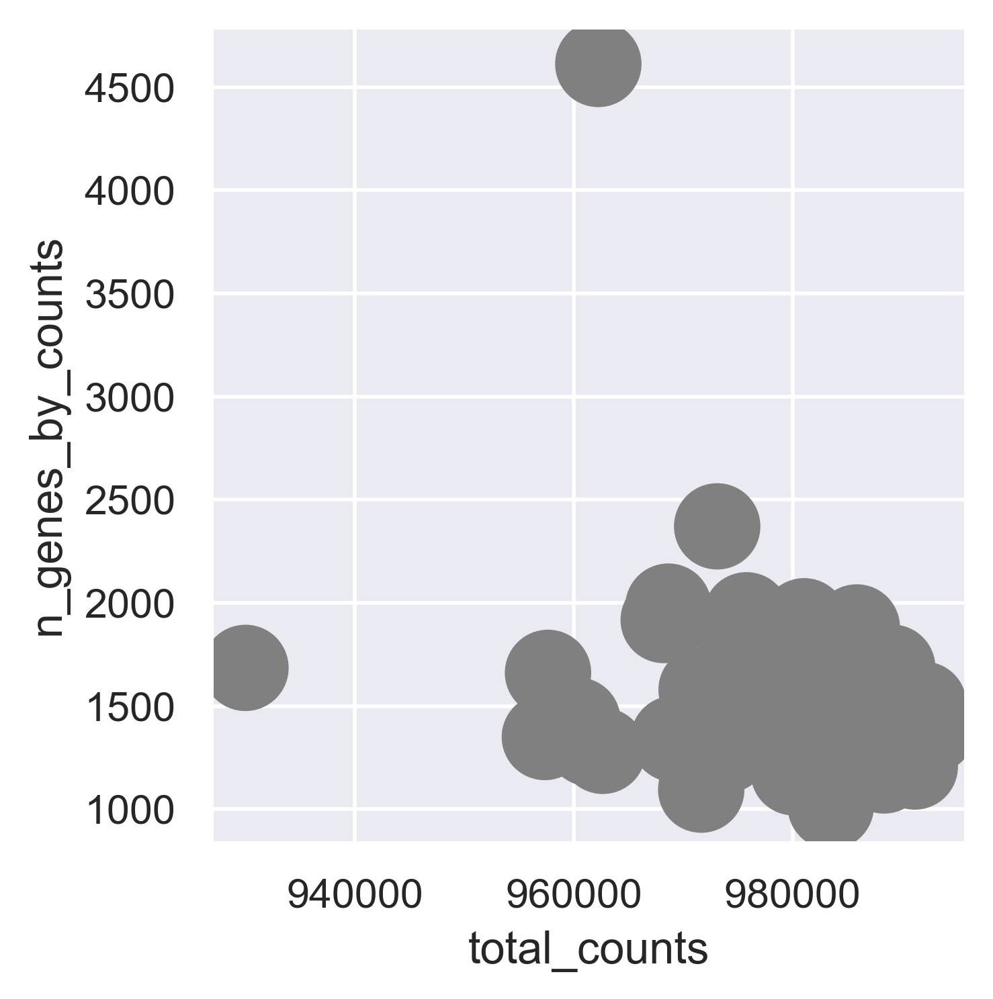

   The shape of adata after filtering is: (56, 8466)


f:\tools\miniconda3\envs\deside3\lib\site-packages\scanpy\preprocessing\_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


In [20]:
for _file in all_files:
    print('#----------------------------------------------')
    print('Deal with {}...'.format(_file))
    current_sample = adata[adata.obs['sample_id']==_file, :]
    current_sample_normalized = normalize_mtx(adata=current_sample, result_dir=result_dir, prefix='', fig_prefix=_file, max_n_genes_by_counts=6000, 
                                              max_pct_counts_mt=10, max_total_counts=1e6+1, log_base=2, filter_genes=True, target_sum=1e6, min_cells=3)
    current_sample_normalized.write(os.path.join(result_dir, _file+'_raw.h5ad'))

In [21]:
sample2dataset = {}
for _file in all_files:
    current_file_path = os.path.join(result_dir, _file + '_raw.h5ad')
    current_dataset = sc.read_h5ad(current_file_path, backed=None)
    current_dataset.obs['sample_id'] = _file
    sample2dataset[_file] = current_dataset

In [22]:
len(sample2dataset)

14

In [23]:
sample2dataset['P1219'].obs.head(2)

,sample_id,majorCluster,sampleType,cell_type,n_genes,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt
UniqueCell_ID,,,,,,,,,
TTH70-20171219,P1219,CD4_C4-CD69,TTH,CD4 Tconv,1547,1463,979134.3125,0.0,0.0
TTY15-20171219,P1219,CD4_C4-CD69,TTY,CD4 Tconv,1127,1095,971642.0625,0.0,0.0


In [24]:
sample2dataset['P1219']

AnnData object with n_obs × n_vars = 56 × 8466
    obs: 'sample_id', 'majorCluster', 'sampleType', 'cell_type', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'log1p'

### 2 mergering all samples together
- https://anndata.readthedocs.io/en/latest/anndata.AnnData.concatenate.html

In [25]:
all_dataset = None
all_dirs = list(sample2dataset.keys())
for i in range(len(sample2dataset)-1):
    print('dealing with {}'.format(all_dirs[i]))
    next_dataset = sample2dataset[all_dirs[i+1]]
    if all_dataset is None:
        current_dataset = sample2dataset[all_dirs[i]]
        all_dataset = current_dataset.concatenate(next_dataset, index_unique=None, join='outer')
    else:
        all_dataset = all_dataset.concatenate(next_dataset, index_unique=None, join='outer')

dealing with P0706
dealing with P0913
dealing with P1118
dealing with P1120
dealing with P1208
dealing with P1202
dealing with P0616A
dealing with P0619
dealing with P0617
dealing with P0729
dealing with P1010
dealing with P1011
dealing with P0616P


In [26]:
all_dataset.obs

,sample_id,majorCluster,sampleType,cell_type,n_genes,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,batch
UniqueCell_ID,,,,,,,,,,
TTH106-20170706,P0706,CD4_C1-CCR7,TTH,CD4 Tconv,2090,2078,995527.4375,0.0,0.0,0
TTH13-20170706,P0706,CD4_C1-CCR7,TTH,CD4 Tconv,1954,1946,997627.5625,0.0,0.0,0
TTH16-20170706,P0706,CD4_C1-CCR7,TTH,CD4 Tconv,1866,1854,993462.3750,0.0,0.0,0
TTH20-20170706,P0706,CD4_C1-CCR7,TTH,CD4 Tconv,1806,1794,998336.5000,0.0,0.0,0
TTH37-20170706,P0706,CD4_C1-CCR7,TTH,CD4 Tconv,1716,1698,997789.7500,0.0,0.0,0
...,...,...,...,...,...,...,...,...,...,...
TTC52-20171219,P1219,CD8_C5-ZNF683,TTC,CD8 T,1377,1242,983397.4375,0.0,0.0,1
TTC58-20171219,P1219,CD8_C5-ZNF683,TTC,CD8 T,1835,1725,986504.0625,0.0,0.0,1
TTC63-20171219,P1219,CD8_C6-LAYN,TTC,CD8 Tex,2001,1911,981056.9375,0.0,0.0,1


In [27]:
all_dataset.obs['sample_id'].unique()

array(['P0706', 'P0913', 'P1118', 'P1120', 'P1208', 'P1202', 'P0616A',
       'P0619', 'P0617', 'P0729', 'P1010', 'P1011', 'P0616P', 'P1219'],
      dtype=object)

In [28]:
all_dataset.var.head(2)

,n_cells-0-0-0-0-0-0-0-0-0-0-0-0-0,mt-0-0-0-0-0-0-0-0-0-0-0-0-0,n_cells_by_counts-0-0-0-0-0-0-0-0-0-0-0-0-0,mean_counts-0-0-0-0-0-0-0-0-0-0-0-0-0,pct_dropout_by_counts-0-0-0-0-0-0-0-0-0-0-0-0-0,total_counts-0-0-0-0-0-0-0-0-0-0-0-0-0,n_cells-1-0-0-0-0-0-0-0-0-0-0-0-0,mt-1-0-0-0-0-0-0-0-0-0-0-0-0,n_cells_by_counts-1-0-0-0-0-0-0-0-0-0-0-0-0,mean_counts-1-0-0-0-0-0-0-0-0-0-0-0-0,...,n_cells_by_counts-1-0,mean_counts-1-0,pct_dropout_by_counts-1-0,total_counts-1-0,n_cells-1,mt-1,n_cells_by_counts-1,mean_counts-1,pct_dropout_by_counts-1,total_counts-1
symbol,,,,,,,,,,,,,,,,,,,,,
A1BG,45.0,False,45.0,3.209617,89.130435,1328.781616,150.0,False,150.0,8.763515,...,49.0,10.863133,62.015504,1401.344238,3.0,False,3.0,7.881884,94.642857,441.385498
A1BG-AS1,24.0,False,24.0,18.917103,94.202899,7831.680176,105.0,False,105.0,20.684120,...,30.0,38.489731,76.744186,4965.175293,NaN,NaN,NaN,NaN,NaN,NaN


In [29]:
all_dataset.var.drop(columns=all_dataset.var.columns.to_list()[1:-1], inplace=True)
all_dataset.var.head(2), all_dataset.var.shape

(          n_cells-0-0-0-0-0-0-0-0-0-0-0-0-0  total_counts-1
 symbol                                                     
 A1BG                                   45.0      441.385498
 A1BG-AS1                               24.0             NaN,
 (18485, 2))

In [30]:
all_dataset

AnnData object with n_obs × n_vars = 4712 × 18485
    obs: 'sample_id', 'majorCluster', 'sampleType', 'cell_type', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch'
    var: 'n_cells-0-0-0-0-0-0-0-0-0-0-0-0-0', 'total_counts-1'

In [31]:
all_dataset.write(os.path.join(result_dir, 'NSCLC_tumor_tissue_Guo_NMed_2018_merged.h5ad'))

... storing 'sample_id' as categorical
... storing 'majorCluster' as categorical
... storing 'sampleType' as categorical


In [32]:
all_dataset = sc.read_h5ad(os.path.join(result_dir, 'NSCLC_tumor_tissue_Guo_NMed_2018_merged.h5ad'))
all_dataset

AnnData object with n_obs × n_vars = 4712 × 18485
    obs: 'sample_id', 'majorCluster', 'sampleType', 'cell_type', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch'
    var: 'n_cells-0-0-0-0-0-0-0-0-0-0-0-0-0', 'total_counts-1'

#### Filter genes by annotation file
- only keep `protein_coding` genes

In [33]:
gene_list_in_bulk = pd.read_csv('../datasets/TCGA/gencode.gene.info.v22.tsv', index_col=0, sep='\t')
gene_list_in_bulk = gene_list_in_bulk.loc[gene_list_in_bulk['gene_type'] == 'protein_coding', :].copy()
print(gene_list_in_bulk.shape)
gene_list_in_bulk.head(2)

(19814, 11)


,gene_name,seqname,start,end,strand,gene_type,gene_status,havana_gene,full_length,exon_length,exon_num
gene_id,,,,,,,,,,,
ENSG00000206557.5,TRIM71,chr3,32818018,32897826,+,protein_coding,KNOWN,OTTHUMG00000155778.3,79809,8685,4
ENSG00000183813.6,CCR4,chr3,32951574,32956349,+,protein_coding,KNOWN,OTTHUMG00000130752.2,4776,3095,2


In [34]:
common_marker_gene = pd.read_csv('selected_marker_genes.csv', index_col=0)
print(common_marker_gene.shape)
common_marker_gene.head(2)

(125, 5)


,cell_type,subset,PMID,comment,core_marker
marker_gene,,,,,
IGHA2,B Cells,B Cells,31712411; 30523328,non-cancer cell,NaN
IGHM,B Cells,B Cells,31712411; 30523328,non-cancer cell,NaN


In [35]:
len(set(all_dataset.var.index) & set(gene_list_in_bulk['gene_name'])), len(set(all_dataset.var.index) & set(common_marker_gene.index)), gene_list_in_bulk.shape, all_dataset.var.shape

(15563, 113, (19814, 11), (18485, 2))

In [36]:
# genes in bulk gene list or marker genes
bulk_marker = set(gene_list_in_bulk['gene_name']) | set(common_marker_gene.index)
len(bulk_marker)

19714

In [37]:
all_dataset = all_dataset[:, all_dataset.var.index.isin(bulk_marker)]
all_dataset

View of AnnData object with n_obs × n_vars = 4712 × 15563
    obs: 'sample_id', 'majorCluster', 'sampleType', 'cell_type', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch'
    var: 'n_cells-0-0-0-0-0-0-0-0-0-0-0-0-0', 'total_counts-1'

### 3. Principal component analysis
- Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.

In [38]:
sc.tl.pca(all_dataset, svd_solver='arpack', n_comps=100, use_highly_variable=False, zero_center=False)

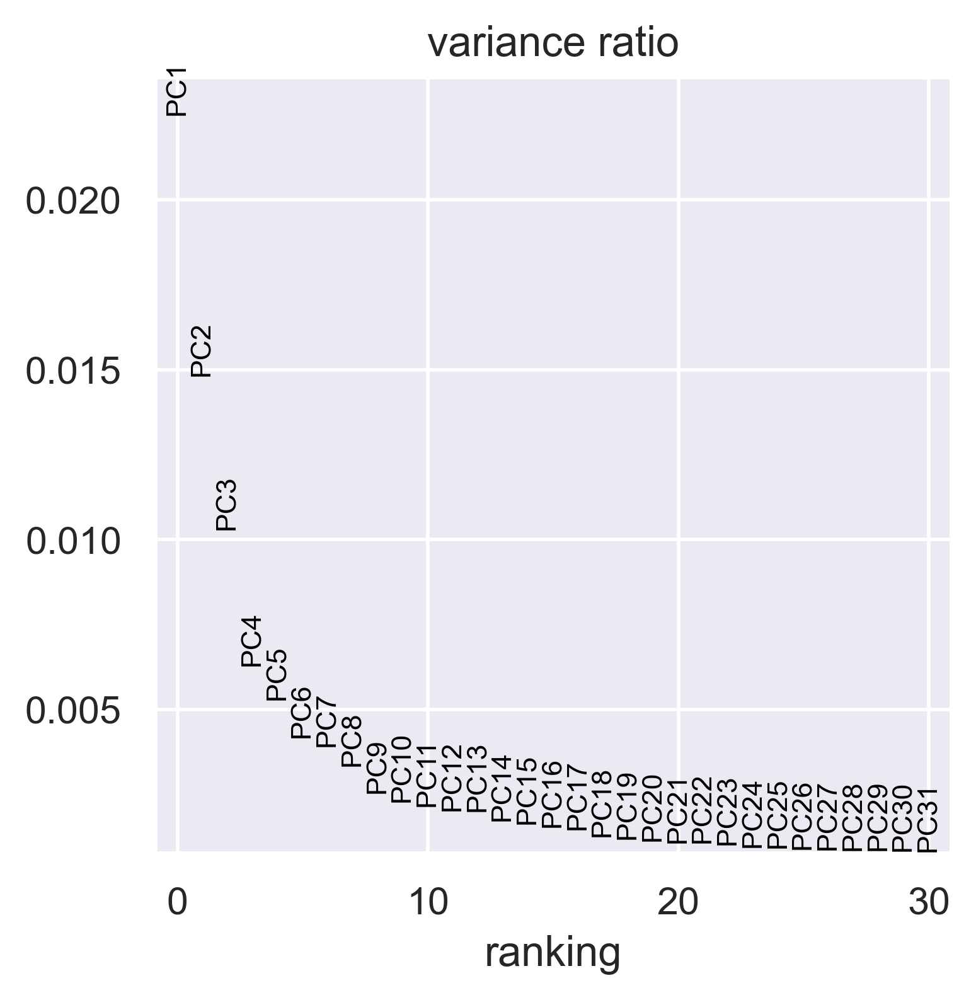

In [39]:
sc.pl.pca_variance_ratio(all_dataset, n_pcs=30)

In [40]:
all_dataset.obsm['X_pca'].shape

(4712, 100)

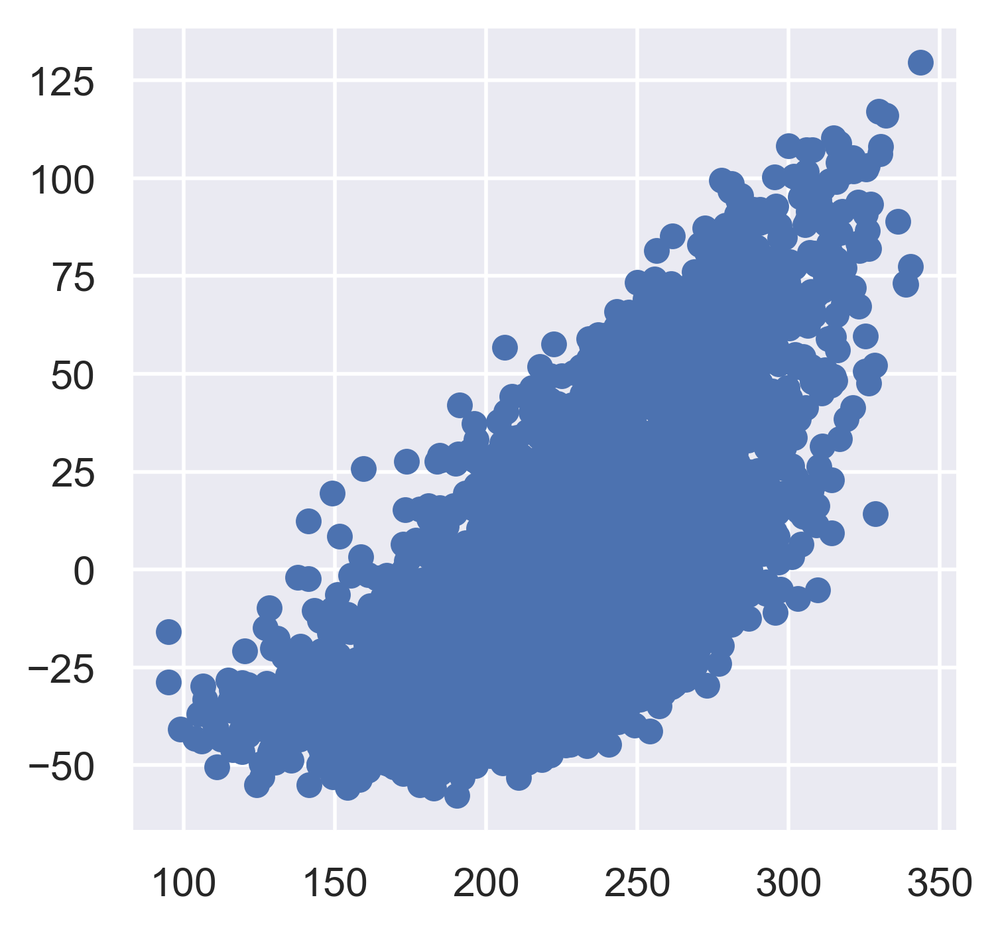

In [41]:
plt.scatter(all_dataset.obsm['X_pca'][:, 0], all_dataset.obsm['X_pca'][:, 1])

### 4. Computing the neighborhood graph and Embedding the neighborhood graph

In [42]:
sc.pp.neighbors(all_dataset, n_neighbors=10, n_pcs=40)

In [43]:
sc.tl.umap(all_dataset)

In [44]:
all_dataset

AnnData object with n_obs × n_vars = 4712 × 15563
    obs: 'sample_id', 'majorCluster', 'sampleType', 'cell_type', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch'
    var: 'n_cells-0-0-0-0-0-0-0-0-0-0-0-0-0', 'total_counts-1'
    uns: 'pca', 'neighbors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [45]:
sc.tl.leiden(all_dataset)

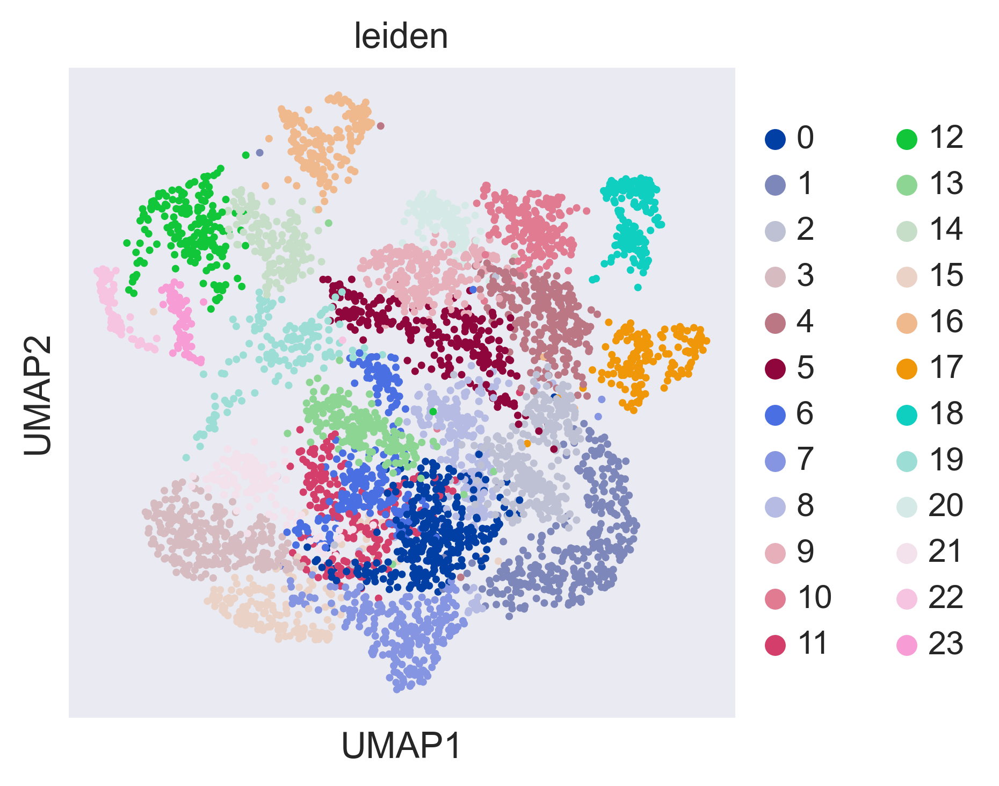

In [46]:
sc.pl.umap(all_dataset, color=['leiden'], save='before_batch_correct_umap_leiden.png')

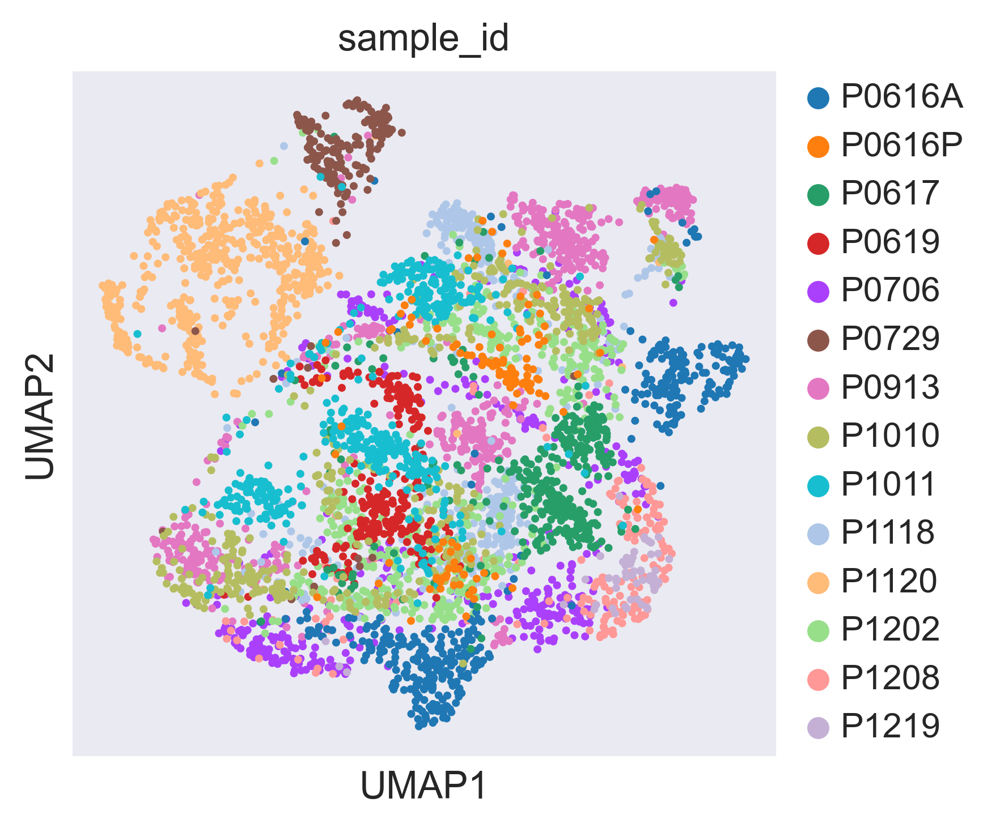

In [47]:
sc.pl.umap(all_dataset, color=['sample_id'], save='before_batch_correct_umap_batch.png')

In [48]:
all_dataset.write(os.path.join(result_dir, 'NSCLC_tumor_tissue_Guo_NMed_2018_merged_before_batch_correction.h5ad'))

### 5. Batch effect correction by BBKNN
- https://scanpy-tutorials.readthedocs.io/en/latest/integrating-data-using-ingest.html#BBKNN

In [49]:
%%time
sc.external.pp.bbknn(all_dataset, batch_key='sample_id')

Wall time: 2.3 s


In [50]:
all_dataset

AnnData object with n_obs × n_vars = 4712 × 15563
    obs: 'sample_id', 'majorCluster', 'sampleType', 'cell_type', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden'
    var: 'n_cells-0-0-0-0-0-0-0-0-0-0-0-0-0', 'total_counts-1'
    uns: 'pca', 'neighbors', 'umap', 'leiden', 'leiden_colors', 'sample_id_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [51]:
%%time
sc.tl.umap(all_dataset)
sc.tl.leiden(all_dataset)

Wall time: 10.8 s


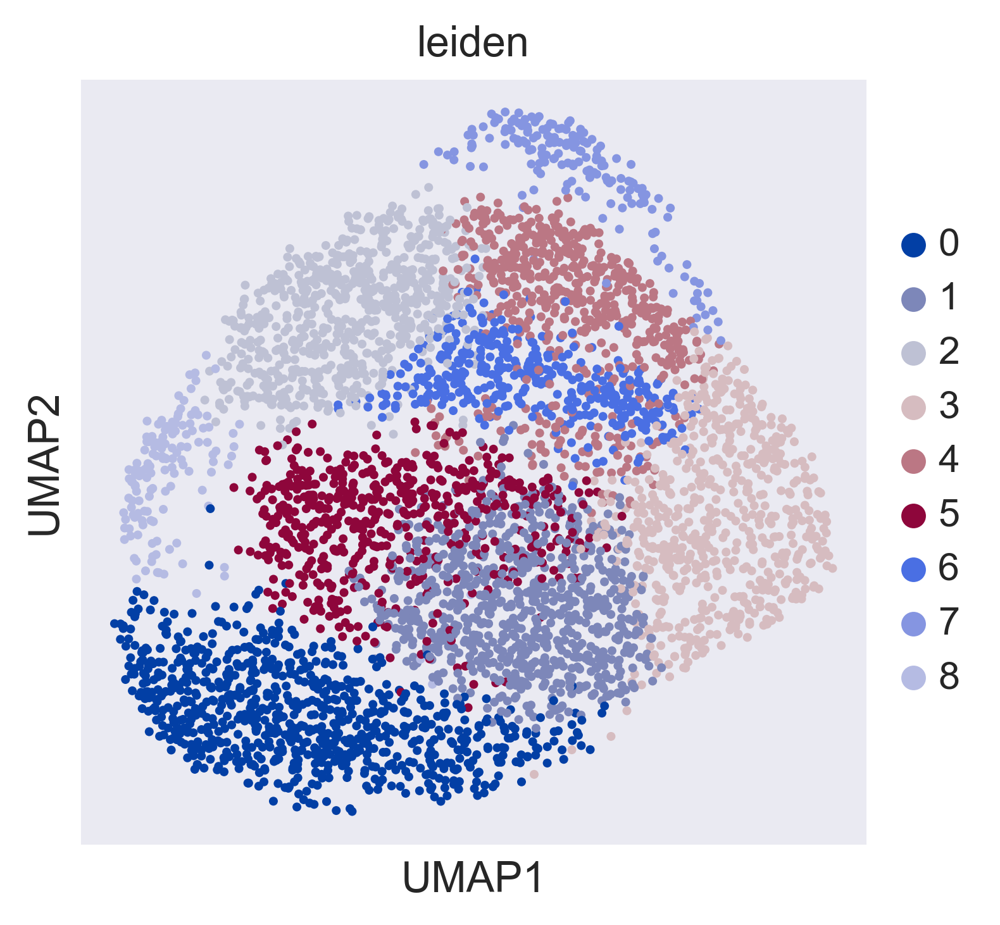

In [52]:
sc.pl.umap(all_dataset, color=['leiden'], save='after_batch_correct_umap_leiden.png')

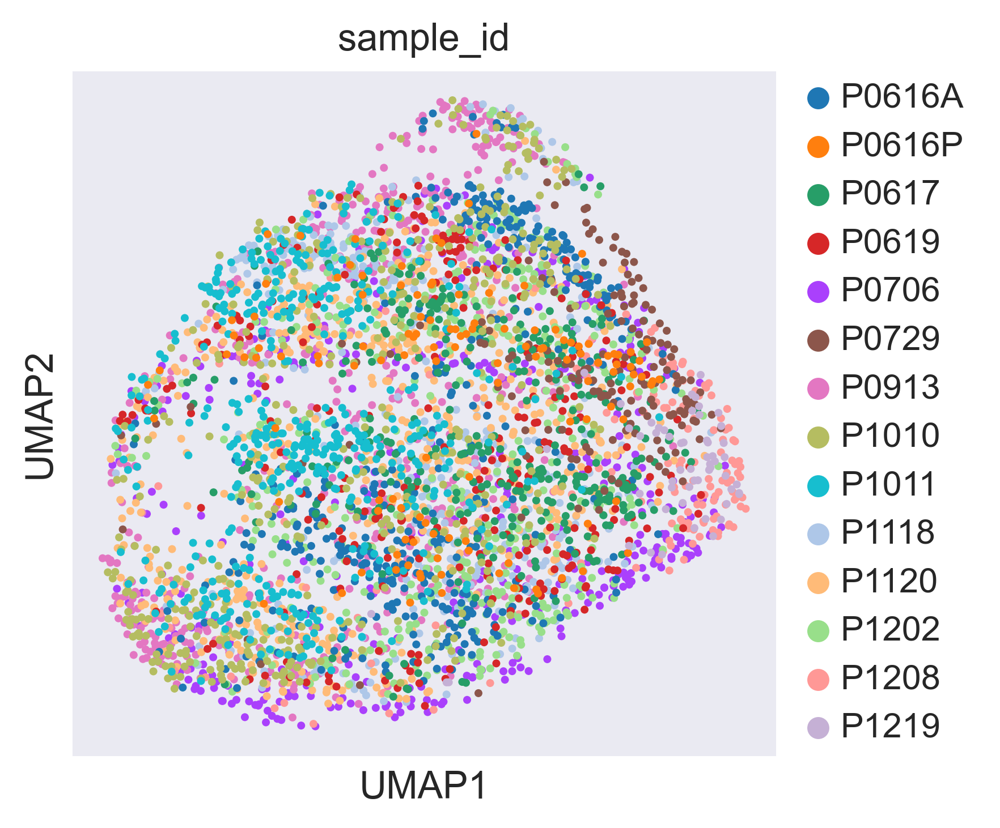

In [53]:
sc.pl.umap(all_dataset, color=['sample_id'], save='after_batch_correct_umap_batch.png')

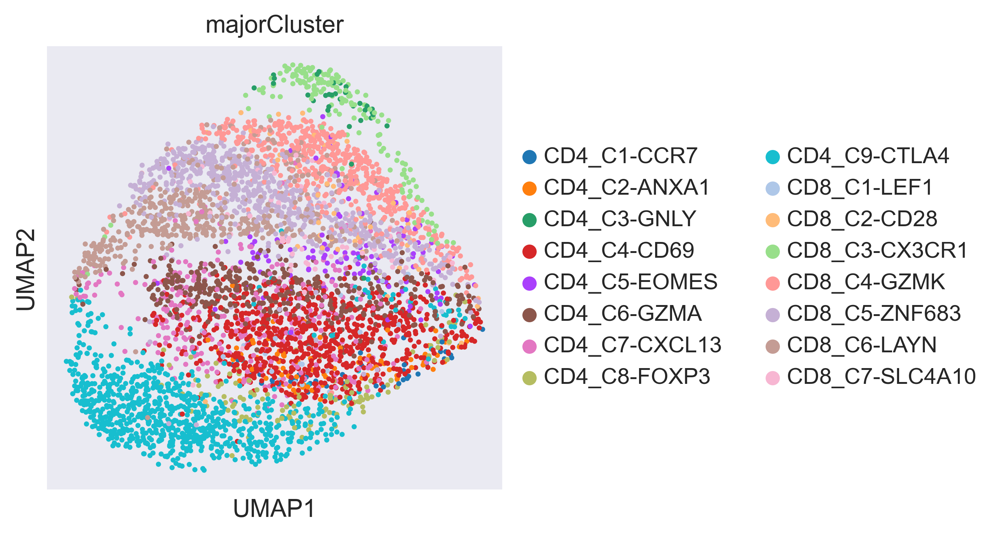

In [54]:
sc.pl.umap(all_dataset, color=['majorCluster'], save='after_batch_correct_umap_majorCluster.png')

In [55]:
all_dataset.obs.head(2)

,sample_id,majorCluster,sampleType,cell_type,n_genes,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,batch,leiden
UniqueCell_ID,,,,,,,,,,,
TTH106-20170706,P0706,CD4_C1-CCR7,TTH,CD4 Tconv,2090,2078,995527.4375,0.0,0.0,0,3
TTH13-20170706,P0706,CD4_C1-CCR7,TTH,CD4 Tconv,1954,1946,997627.5625,0.0,0.0,0,3


In [56]:
all_dataset.write(os.path.join(file_path, 'preprocessing', 'NSCLC_tumor_tissue_Guo_NMed_2018_merged_after_batch_correction.h5ad'))

### 6. Finding marker genes

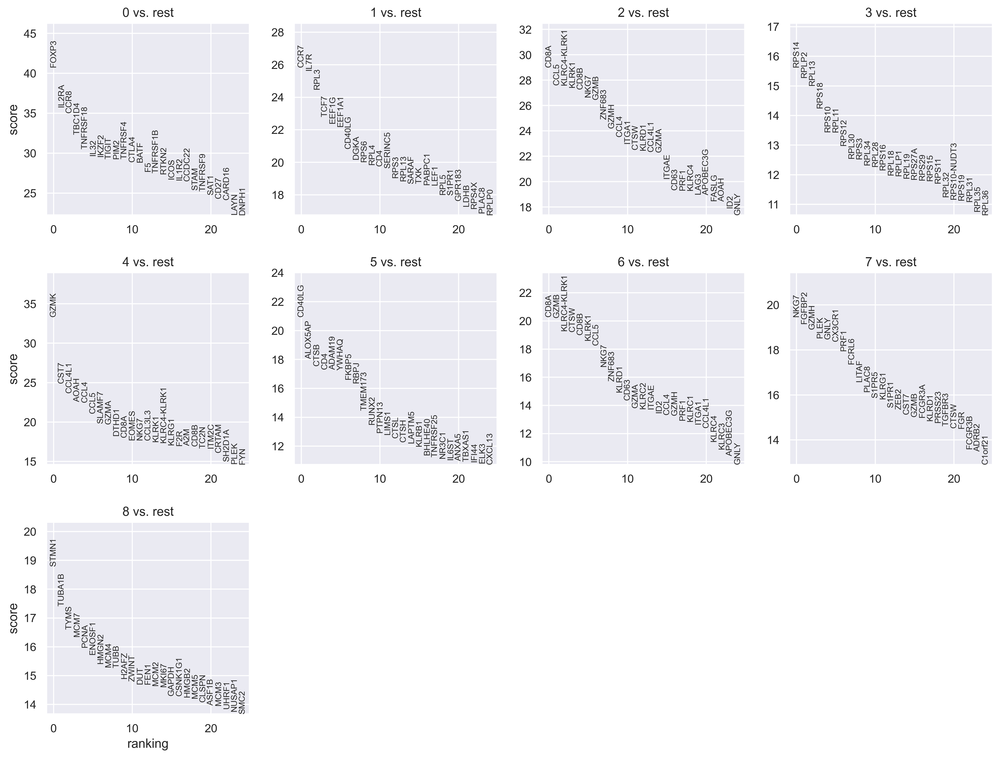

In [57]:
sc.tl.rank_genes_groups(all_dataset, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(all_dataset, n_genes=25, sharey=False)

In [58]:
top30 = pd.DataFrame(all_dataset.uns['rank_genes_groups']['names']).head(30)
top30

,0,1,2,3,4,5,6,7,8
0,FOXP3,CCR7,CD8A,RPS14,GZMK,CD40LG,CD8A,NKG7,STMN1
1,IL2RA,IL7R,CCL5,RPLP2,CST7,ALOX5AP,GZMB,FGFBP2,TUBA1B
2,CCR8,RPL3,KLRC4-KLRK1,RPL13,CCL4L1,CTSB,KLRC4-KLRK1,GZMH,TYMS
3,TBC1D4,TCF7,KLRK1,RPS18,AOAH,CD4,CTSW,PLEK,MCM7
4,TNFRSF18,EEF1G,CD8B,RPS10,CCL4,ADAM19,CD8B,GNLY,PCNA
5,IL32,EEF1A1,NKG7,RPL11,CCL5,YWHAQ,KLRK1,CX3CR1,ENOSF1
6,IKZF2,CD40LG,GZMB,RPS12,SLAMF7,FKBP5,CCL5,PRF1,HMGN2
7,TIGIT,DGKA,ZNF683,RPL30,GZMA,RBPJ,NKG7,FCRL6,MCM4
8,PIM2,RPS6,GZMH,RPS3,DTHD1,TMEM173,ZNF683,LITAF,TUBB
9,TNFRSF4,RPL4,CCL4,RPL34,CD8A,RUNX2,KLRD1,PLAC8,H2AFZ


In [59]:
common_marker_gene = pd.read_csv('selected_marker_genes.csv', index_col=0)
common_marker_gene.head(2)

,cell_type,subset,PMID,comment,core_marker
marker_gene,,,,,
IGHA2,B Cells,B Cells,31712411; 30523328,non-cancer cell,NaN
IGHM,B Cells,B Cells,31712411; 30523328,non-cancer cell,NaN


In [60]:
for cluster_id in top30:
    print('Current cluster id: {}'.format(cluster_id))
    print(top30.loc[:, [cluster_id]].merge(common_marker_gene, left_on=cluster_id, right_index=True).iloc[:, range(2)])

Current cluster id: 0
          0      cell_type
0     FOXP3          CD4 T
1     IL2RA          CD4 T
6     IKZF2          CD4 T
7     TIGIT  CD4 T / CD8 T
9   TNFRSF4          CD4 T
10    CTLA4  CD4 T / CD8 T
11     BATF          CD4 T
15     ICOS          CD4 T
19  TNFRSF9          CD4 T
23     LAYN          CD8 T
25     SELL          CD4 T
27     CD28          CD4 T
Current cluster id: 1
       1            cell_type
0   CCR7           CD4 T / DC
1   IL7R                CD4 T
3   TCF7                CD4 T
10   CD4  CD4 T / Macrophages
27  SELL                CD4 T
Current cluster id: 2
         2   cell_type
0     CD8A       CD8 T
1     CCL5       CD8 T
4     CD8B       CD8 T
5     NKG7  CD8 T / NK
6     GZMB  CD8 T / DC
12   KLRD1          NK
14    GZMA       CD8 T
17    PRF1  CD8 T / NK
19    LAG3       CD8 T
24    GNLY  CD8 T / NK
28  SLAMF7     B Cells
Current cluster id: 3
Empty DataFrame
Columns: [3, cell_type]
Index: []
Current cluster id: 4
         4   cell_type
5     CCL5

In [62]:
marker_genes1 = ["PDCD1", "IFNG", "CD2", "CD3D", "CD3E", # T Cell
                 "BATF", "ICOS", "IL7R", "SELL", "TNFRSF4", "CXCL13", "CXCR5", "MAF", "IL12RB2", "STAT4", "CREM", "IRF4", "NR4A2", 
                 "GATA3", "STAT6", "TCF7", "IKZF2", "IL2RA", "TGFB1", "TGFB3", "TGFBR1", "CD28", "TNFRSF14", "TNFRSF9", 
                 "FOXP3", "CTLA4", "TIGIT", "CCR7", "CD4",  # CD4 T
                 "CX3CR1", "IL2", "CCL5", "CD8A", "CD8B", "GZMA", "LAYN", "LAG3", "GZMB", "GNLY", "NKG7", "PRF1", # CD8 T
                 "NCAM1", "KLRF1", "XCL1", "KLRD1", "SAMD3", "SH2D1B", "TBX21"]  # NK

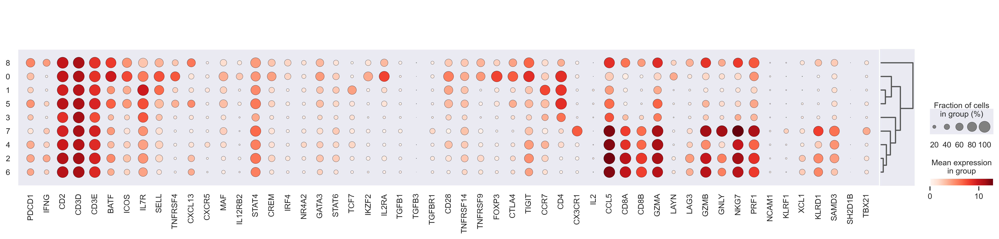

In [63]:
sc.pl.dotplot(all_dataset, marker_genes1, groupby='leiden', save='marker_genes_dotplot.png', dendrogram=True)

In [64]:
# Exhausted CD8 T (Tex)
# follicular T helper (Tfh)
# Plasmacytoid dendritic cells (pDC)
new_cluster_names = {
    0: 'CD4 T (1)',
    1: 'CD4 T (2)',
    2: 'CD8 T (1)',
    3: 'CD4 T (3)',
    4: 'CD8 T (2)',
    5: 'CD4 T (4)',
    6: 'CD8 T (3)',
    7: 'CD8 T (4)',
    8: 'CD8 T (5)'
}
new_cluster_names_val = list(new_cluster_names.values())
print(new_cluster_names_val)
all_dataset.rename_categories('leiden', new_cluster_names_val)

['CD4 T (1)', 'CD4 T (2)', 'CD8 T (1)', 'CD4 T (3)', 'CD8 T (2)', 'CD4 T (4)', 'CD8 T (3)', 'CD8 T (4)', 'CD8 T (5)']


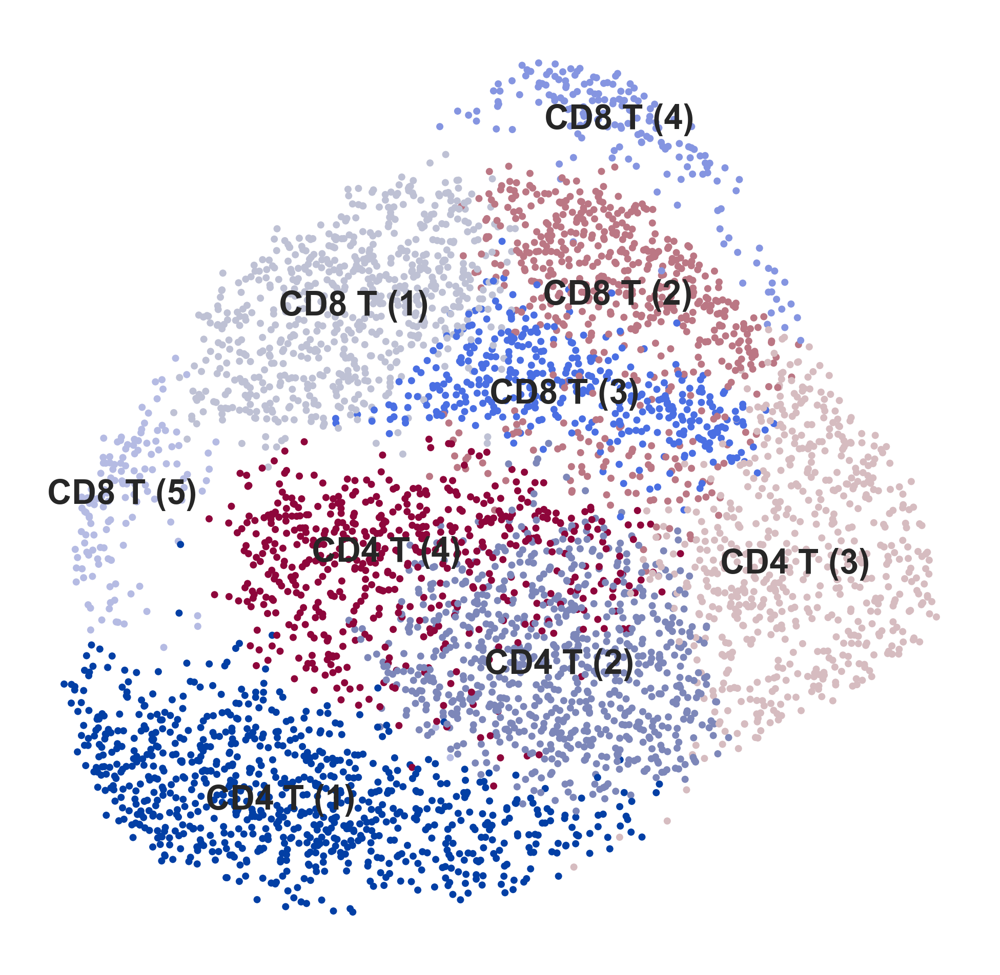

In [65]:
# plt.figure(figsize=(15, 15))
rcParams['figure.figsize'] = 6, 6
sc.pl.umap(all_dataset, color='leiden', legend_loc='on data', legend_fontsize='medium', 
           title='', frameon=False, save='.png')

#### Compare with original cell type

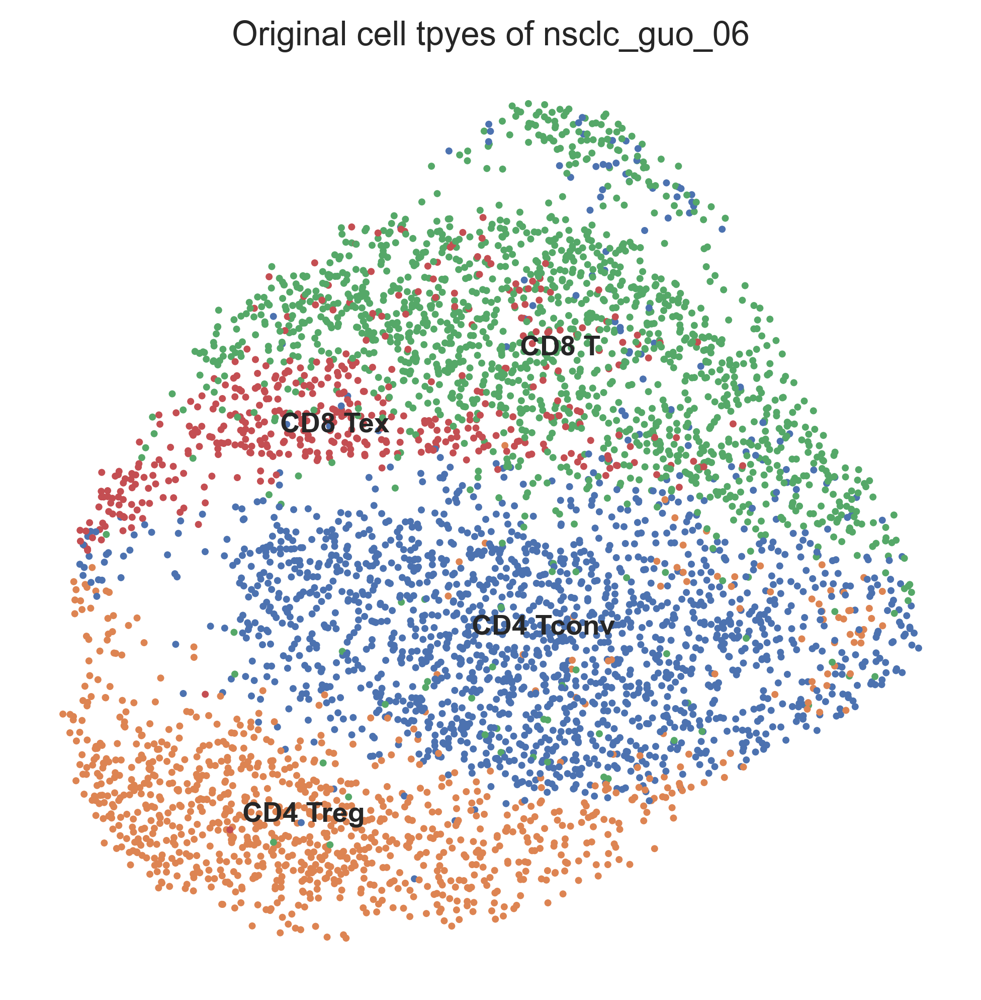

In [66]:
# rcParams['figure.figsize'] = 10, 10
sc.pl.umap(all_dataset, color='cell_type', legend_loc='on data', legend_fontsize='small', 
           title='Original cell tpyes of nsclc_guo_06', frameon=False)

In [67]:
cell_type_mapping_leiden = {
 'CD4 T (1)': 'CD4 T',
 'CD4 T (2)': 'CD4 T',
 'CD4 T (3)': 'CD4 T',
 'CD4 T (4)': 'CD4 T',
 'CD8 T (5)': 'CD8 T',
 'CD8 T (2)': 'CD8 T',
 'CD8 T (3)': 'CD8 T',
 'CD8 T (1)': 'CD8 T',
 'CD8 T (4)': 'CD8 T'
}

In [68]:
cell_type_mapping_cluster = {
 'CD4 Tconv': 'CD4 T',
 'CD4 Treg': 'CD4 T',
 'CD8 T': 'CD8 T',
 'CD8 Tex': 'CD8 T'
}

In [69]:
all_dataset.obs['cell_type1'] = all_dataset.obs.leiden.map(cell_type_mapping_leiden)
all_dataset.obs['original_cell_type'] = all_dataset.obs.cell_type.map(cell_type_mapping_cluster)
all_dataset.obs.head(2)

,sample_id,majorCluster,sampleType,cell_type,n_genes,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,batch,leiden,cell_type1,original_cell_type
UniqueCell_ID,,,,,,,,,,,,,
TTH106-20170706,P0706,CD4_C1-CCR7,TTH,CD4 Tconv,2090,2078,995527.4375,0.0,0.0,0,CD4 T (3),CD4 T,CD4 T
TTH13-20170706,P0706,CD4_C1-CCR7,TTH,CD4 Tconv,1954,1946,997627.5625,0.0,0.0,0,CD4 T (3),CD4 T,CD4 T


Remove cells with different cell type between `cell_type1` and `original_cell_type`.

In [70]:
nsclc_06_obs = all_dataset.obs.copy()
nsclc_06_obs_bool = nsclc_06_obs['cell_type1'] == nsclc_06_obs['original_cell_type']
print(sum(nsclc_06_obs_bool))
all_dataset = all_dataset[nsclc_06_obs_bool, :].copy()

4250


In [71]:
for i, group in all_dataset.obs.groupby(['leiden']):
    n_cell = group.shape[0]
    accuracy = np.sum(group['cell_type1'] == group['original_cell_type']) / n_cell  # annotated same cell type as original cell type
    print(i, round(accuracy, 3), n_cell)

CD4 T (1) 1.0 812
CD4 T (2) 1.0 754
CD8 T (1) 1.0 660
CD4 T (3) 1.0 425
CD8 T (2) 1.0 464
CD4 T (4) 1.0 544
CD8 T (3) 1.0 374
CD8 T (4) 1.0 139
CD8 T (5) 1.0 78


In [72]:
all_dataset.var = all_dataset.var.rename(columns={'n_cells-0-0-0-0-0-0-0-0-0-0-0-0-0': 'n_cells'})

In [73]:
all_dataset

AnnData object with n_obs × n_vars = 4250 × 15563
    obs: 'sample_id', 'majorCluster', 'sampleType', 'cell_type', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden', 'cell_type1', 'original_cell_type'
    var: 'n_cells', 'total_counts-1'
    uns: 'pca', 'neighbors', 'umap', 'leiden', 'sample_id_colors', 'majorCluster_colors', 'rank_genes_groups', 'dendrogram_leiden', 'cell_type_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [74]:
all_dataset.write(os.path.join(result_dir, 'NSCLC_tumor_tissue_Guo_NMed_2018_merged_after_batch_correction.h5ad'))

... storing 'cell_type1' as categorical
... storing 'original_cell_type' as categorical


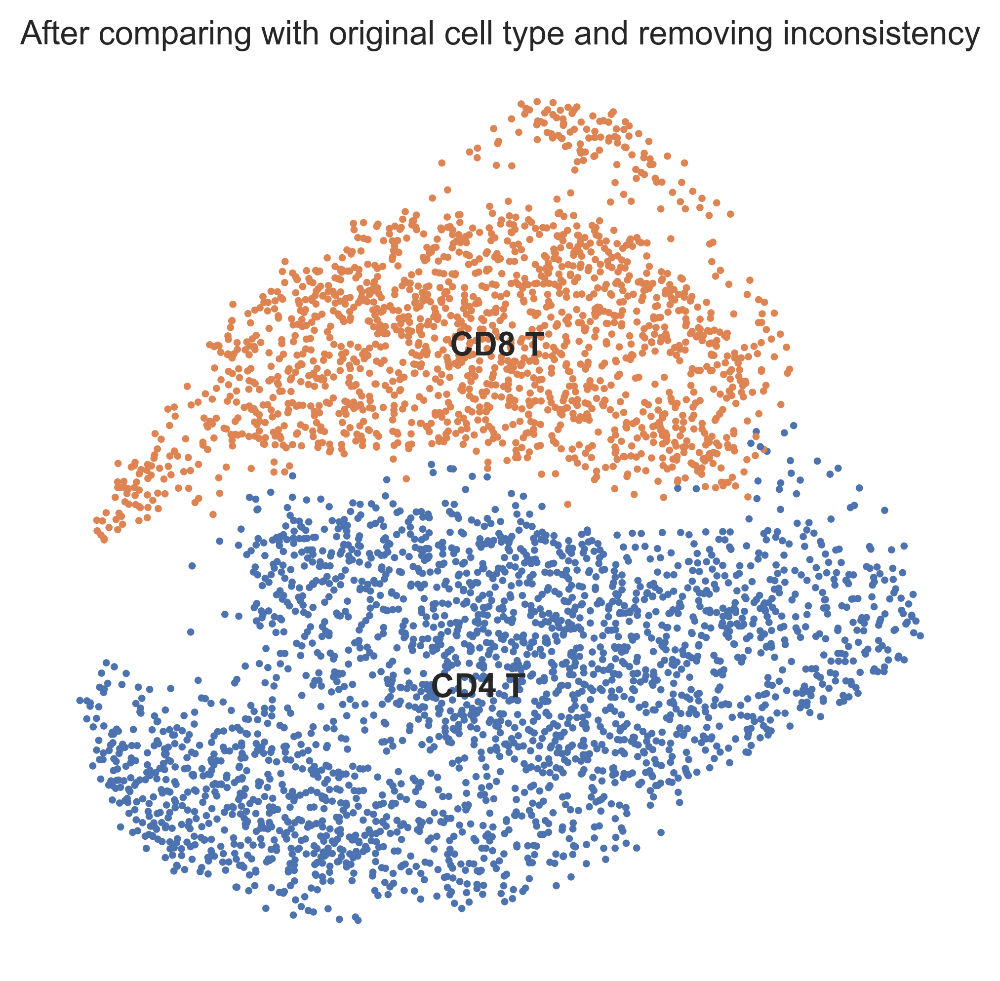

In [75]:
sc.pl.umap(all_dataset, color='cell_type1', legend_loc='on data', legend_fontsize='medium', 
           title='After comparing with original cell type and removing inconsistency', frameon=False)